### Final annotation of Epithelial cells from small intestine (first trimester)


Preprocessing:
- epithelial cells from main object subsetted, then subsetted cells from small intesine, and further subsetted only cells from first trimester patients
- performed scvi batch correction to prepare objects

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/post_scvi20221124/SI_FT_epi.hvg5000_noRPL.scvi_output.with_annotv2.22021124.h5ad')

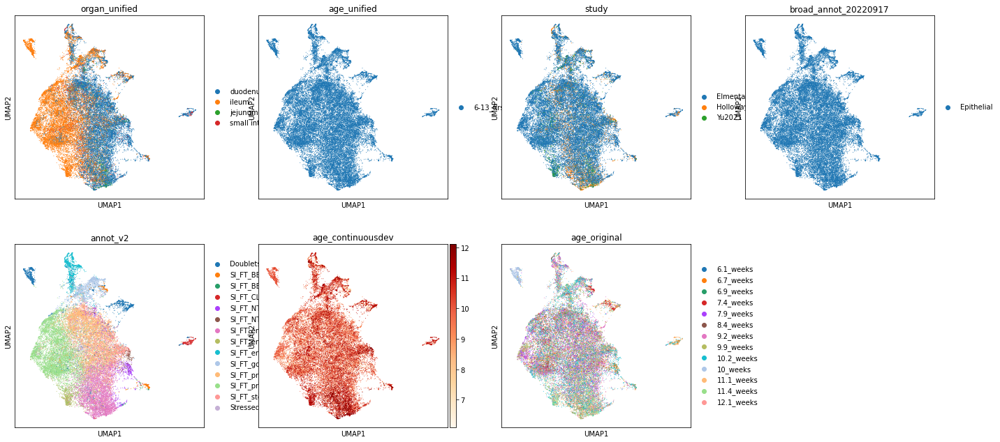

In [30]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata, color=['organ_unified', 'age_unified','study','broad_annot_20220917','annot_v2','age_continuousdev','age_original'],cmap='OrRd')

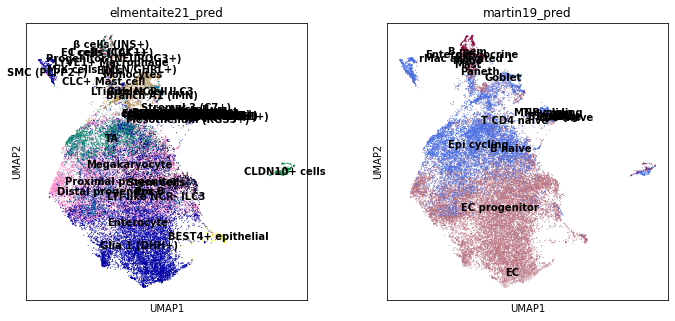

In [4]:
sc.pl.umap(adata, color=['elmentaite21_pred','martin19_pred'],legend_loc='on data')

In [6]:
adata.X.max()

10809.0

In [7]:
#save raw counts in layers
adata.layers['counts'] = adata.X
#normalise and transform
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
sc.pp.log1p(adata)

In [8]:
adata.X.max()

8.705784

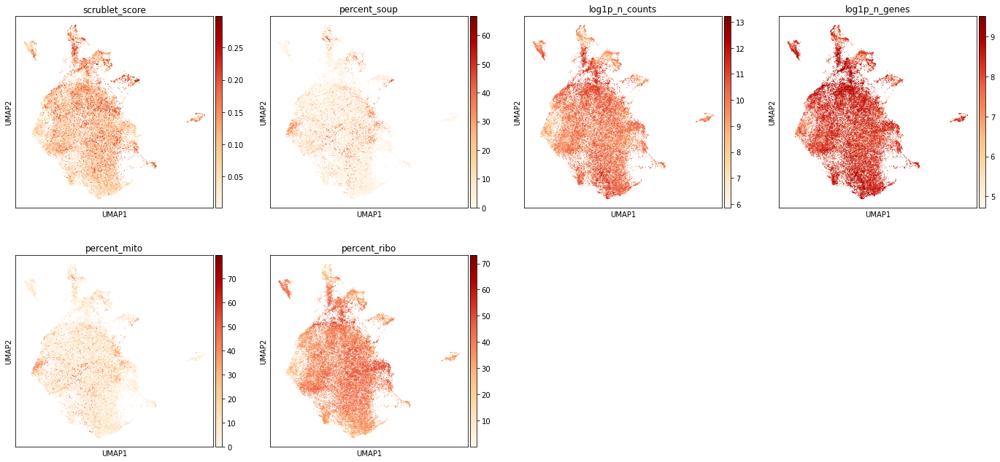

In [9]:
#plot some basic QC
sc.pl.umap(adata, color = ['scrublet_score','percent_soup','log1p_n_counts','log1p_n_genes','percent_mito','percent_ribo'],cmap='OrRd')

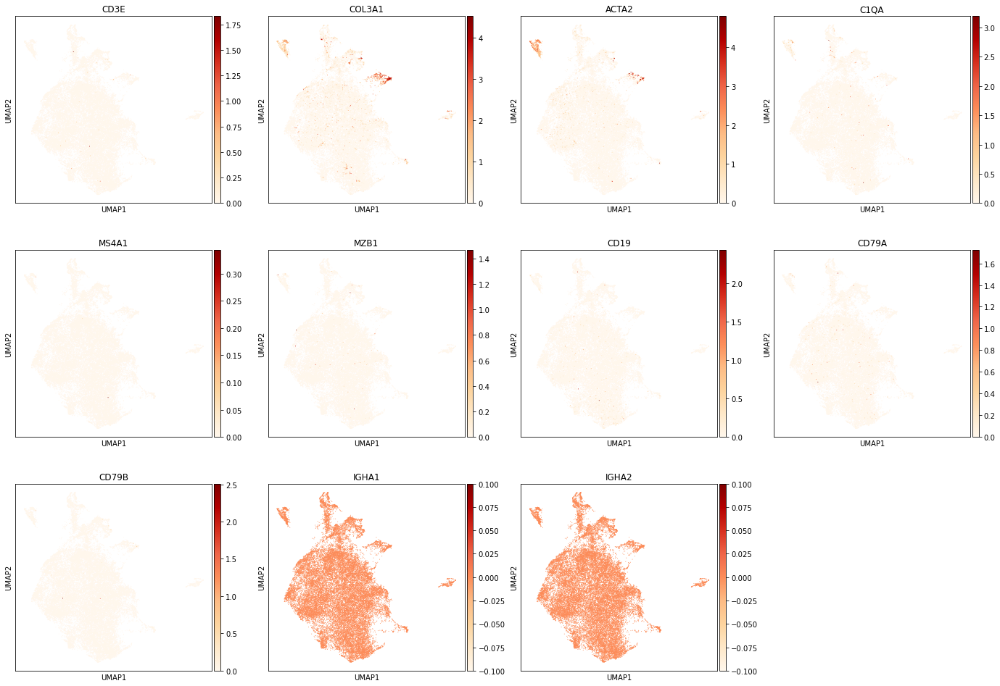

In [10]:
#plot doublet genes
sc.pl.umap(adata, color = ['CD3E','COL3A1','ACTA2','C1QA','MS4A1','MZB1','CD19','CD79A','CD79B','IGHA1','IGHA2'],cmap='OrRd')

In [11]:
#score cell cycle genes
cell_cycle_genes = ['MCM5',
'PCNA',
 'TYMS',
 'FEN1',
 'MCM2',
 'MCM4',
 'RRM1',
 'UNG',
 'GINS2',
 'MCM6',
 'CDCA7',
 'DTL',
 'PRIM1',
 'UHRF1',
 'MLF1IP',
 'HELLS',
 'RFC2',
 'RPA2',
 'NASP',
 'RAD51AP1',
 'GMNN',
 'WDR76',
 'SLBP',
 'CCNE2',
 'UBR7',
 'POLD3',
 'MSH2',
 'ATAD2',
 'RAD51',
 'RRM2',
 'CDC45',
 'CDC6',
 'EXO1',
 'TIPIN',
 'DSCC1',
 'BLM',
 'CASP8AP2',
 'USP1',
 'CLSPN',
 'POLA1',
 'CHAF1B',
 'BRIP1',
 'E2F8',
 'HMGB2',
 'CDK1',
 'NUSAP1',
 'UBE2C',
 'BIRC5',
 'TPX2',
 'TOP2A',
 'NDC80',
 'CKS2',
 'NUF2',
 'CKS1B',
 'MKI67',
 'TMPO',
 'CENPF',
 'TACC3',
 'FAM64A',
 'SMC4',
 'CCNB2',
 'CKAP2L',
 'CKAP2',
 'AURKB',
 'BUB1',
 'KIF11',
 'ANP32E',
 'TUBB4B',
 'GTSE1',
 'KIF20B',
 'HJURP',
 'CDCA3',
 'HN1',
 'CDC20',
 'TTK',
 'CDC25C',
 'KIF2C',
 'RANGAP1',
 'NCAPD2',
 'DLGAP5',
 'CDCA2',
 'CDCA8',
 'ECT2',
 'KIF23',
 'HMMR',
 'AURKA',
 'PSRC1',
 'ANLN',
 'LBR',
 'CKAP5',
 'CENPE',
 'CTCF',
 'NEK2',
 'G2E3',
 'GAS2L3',
 'CBX5',
 'CENPA']

In [12]:
s_genes = cell_cycle_genes[:43]
g2m_genes = cell_cycle_genes[43:]
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)
adata = adata[adata.obs.G2M_score.sort_values(ascending=True).index].copy()

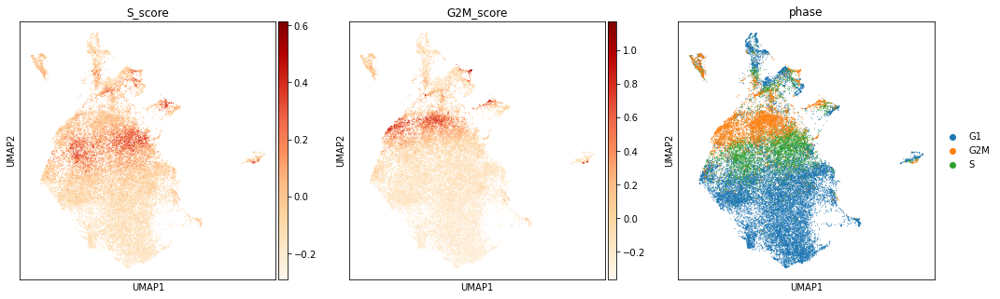

In [13]:
sc.pl.umap(adata,color=['S_score', 'G2M_score', 'phase'],cmap='OrRd')

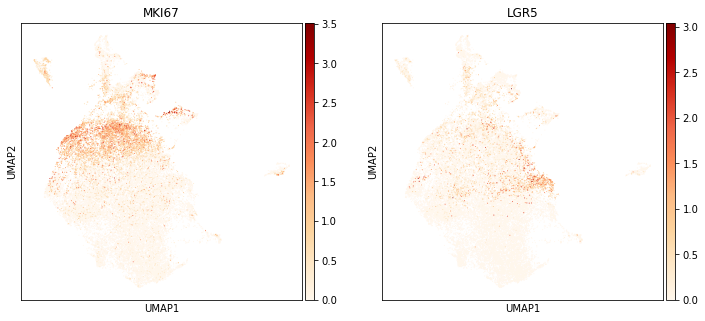

In [27]:
sc.pl.umap(adata,color=['MKI67','LGR5'],cmap='OrRd')

In [21]:
sc.tl.leiden(adata, resolution = 0.4, neighbors_key="neighbors_scvi")

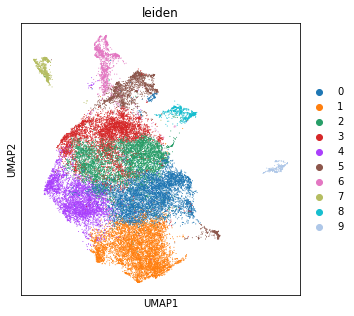

In [22]:
sc.pl.umap(adata,color=['leiden'])

In [9]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import *

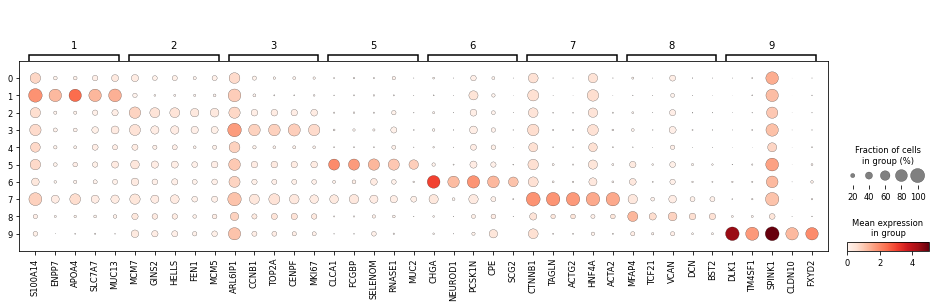

In [24]:
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='leiden', mks=mks)

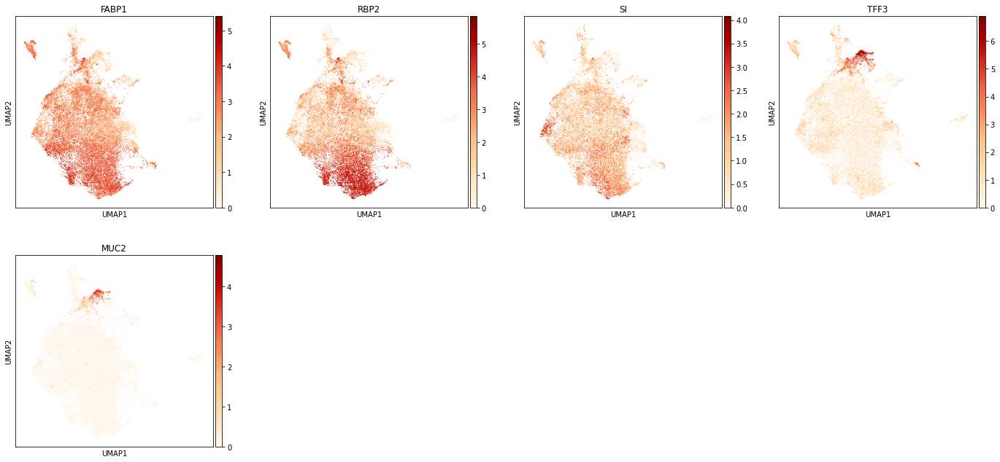

In [33]:
sc.pl.umap(adata,color=['FABP1','RBP2','SI','TFF3','MUC2'],cmap='OrRd')

In [25]:
pd.set_option('display.max_columns', 100)
pd.crosstab(adata.obs.annot_v2,adata.obs.leiden)

leiden,0,1,2,3,4,5,6,7,8,9
annot_v2,,,,,,,,,,
Doublets,51,113,120,80,69,101,65,613,579,34
SI_FT_BEST4,26,10,5,14,24,317,0,0,0,1
SI_FT_BEST4_NTS,0,12,0,2,0,32,0,0,0,0
SI_FT_CLDN10,0,0,1,2,0,0,0,0,0,271
SI_FT_NTS,395,133,81,136,0,22,0,0,0,0
SI_FT_NTS_stem_cell,232,1,38,45,0,3,0,0,0,2
SI_FT_enterocyte,1088,4318,278,218,68,7,6,0,0,0
SI_FT_enterocyte_ileum,0,634,5,11,128,1,0,0,0,0
SI_FT_enteroendocrine,28,7,34,28,6,34,1135,0,2,0


In [26]:
adata.obs.annot_v2.value_counts()

SI_FT_proximal_progenitor_ileum    8154
SI_FT_proximal_progenitor          6790
SI_FT_enterocyte                   5983
SI_FT_stem_cells                   2291
SI_FT_goblet                       1948
Doublets                           1825
SI_FT_enteroendocrine              1274
SI_FT_enterocyte_ileum              779
SI_FT_NTS                           767
Stressed                            707
SI_FT_BEST4                         397
SI_FT_NTS_stem_cell                 321
SI_FT_CLDN10                        274
SI_FT_BEST4_NTS                      46
Name: annot_v2, dtype: int64

In [34]:
new_cluster_names = [
    'SI_FT_proximal_progenitor','SI_FT_enterocyte', #0,1
    'SI_FT_cycling_progenitor','SI_FT_cycling_progenitor', #2,3
    'SI_FT_proximal_progenitor','SI_FT_goblet', #4,5
    'SI_FT_enteroendocrine','Doublets', #6,7 
    'Doublets','SI_FT_CLDN10' #8,9

]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

adata.obs['annot_v3'] = [conv[x] for x in adata.obs['leiden']]

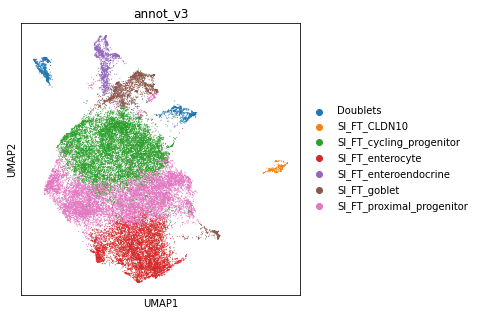

In [35]:
sc.pl.umap(adata,color='annot_v3')

In [36]:
ent = adata[adata.obs.annot_v3.isin(['SI_FT_enterocyte'])].copy()

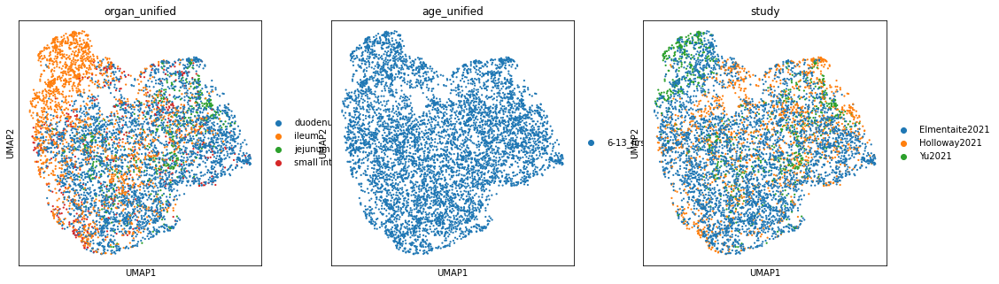

In [37]:
sc.pp.neighbors(
        ent,
            use_rep="X_scvi",
            n_pcs=ent.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(ent, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(ent, color=['organ_unified', 'age_unified','study'])

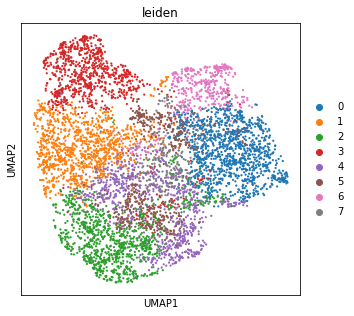

In [41]:
sc.tl.leiden(ent, resolution = 0.7, neighbors_key="neighbors_scvi")
sc.pl.umap(ent, color=['leiden'])

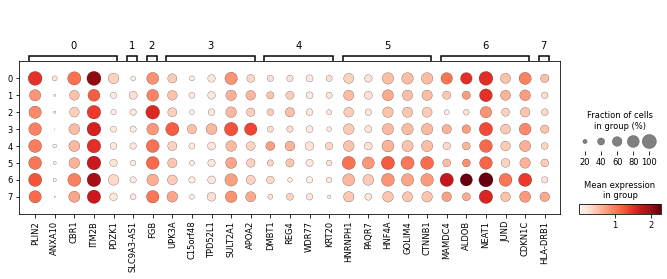

In [42]:
ent.raw = ent.copy()
mkst = calc_marker_stats(ent, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(ent, groupby='leiden', mks=mks)

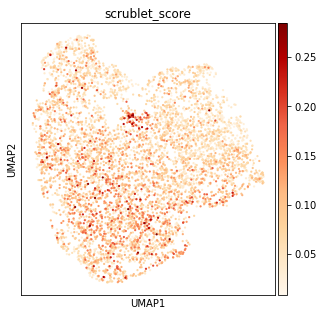

In [43]:
sc.pl.umap(ent,color='scrublet_score',cmap='OrRd')

In [45]:
gob = adata[adata.obs.annot_v3.isin(['SI_FT_goblet'])].copy()

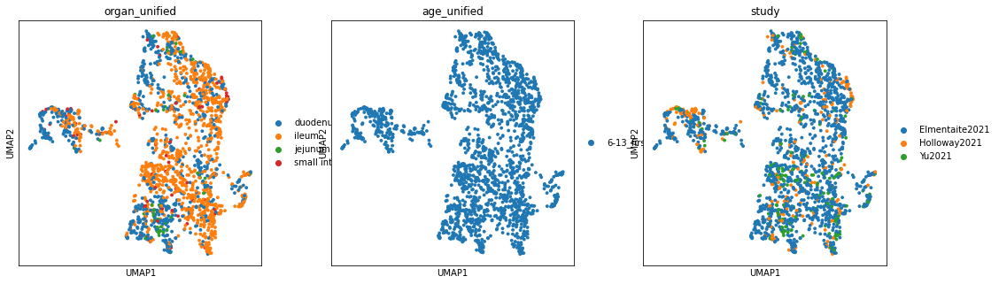

In [46]:
sc.pp.neighbors(
            gob,
            use_rep="X_scvi",
            n_pcs=gob.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(gob, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(gob, color=['organ_unified', 'age_unified','study'])

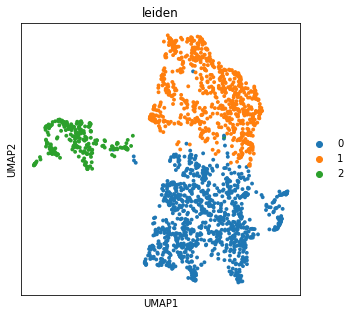

In [47]:
sc.tl.leiden(gob, resolution = 0.2, neighbors_key="neighbors_scvi")
sc.pl.umap(gob, color=['leiden'])

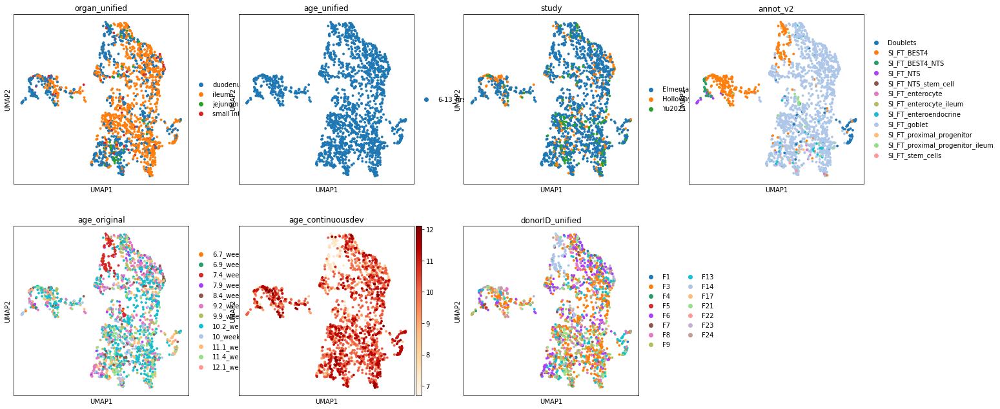

In [51]:
sc.pl.umap(gob, color=['organ_unified', 'age_unified','study','annot_v2','age_original','age_continuousdev','donorID_unified'],cmap='OrRd')

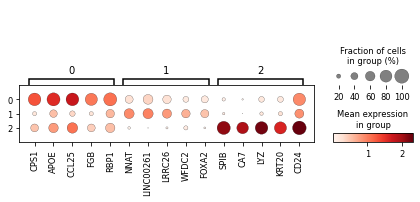

In [52]:
gob.raw = gob.copy()
mkst = calc_marker_stats(gob, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(gob, groupby='leiden', mks=mks)

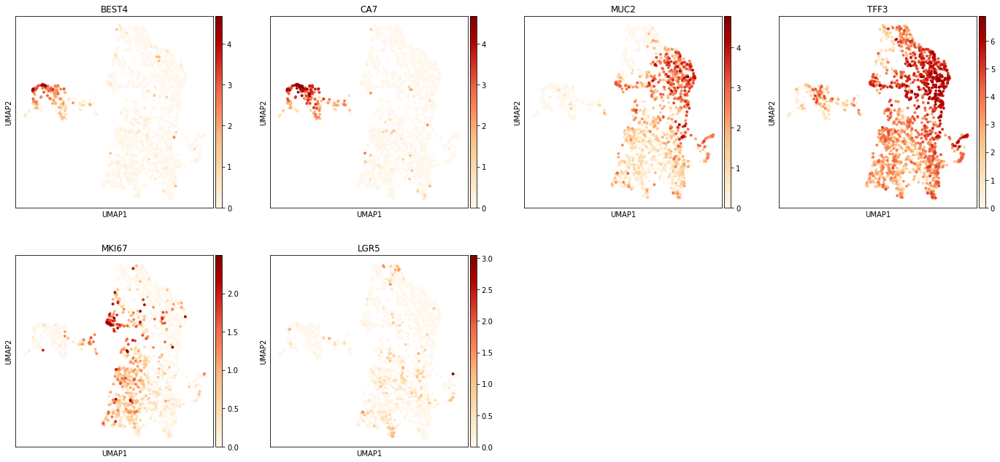

In [56]:
sc.pl.umap(gob,color=['BEST4','CA7','MUC2','TFF3','MKI67','LGR5'],cmap='OrRd')

In [57]:
new_cluster_names = [
    'SI_FT_goblet','SI_FT_goblet', #0,1
    'SI_FT_BEST4'#2

]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

gob.obs['annot_v3'] = [conv[x] for x in gob.obs['leiden']]

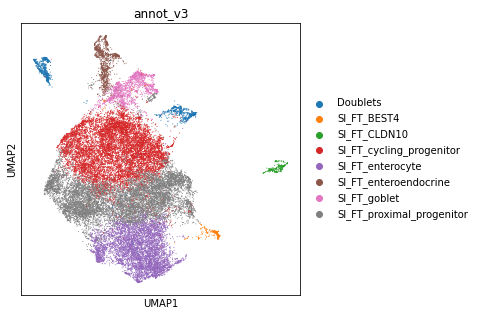

In [58]:
ON = {O:N for O,N in zip(gob.obs_names,gob.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [59]:
pp = adata[adata.obs.annot_v3.isin(['SI_FT_proximal_progenitor'])].copy()

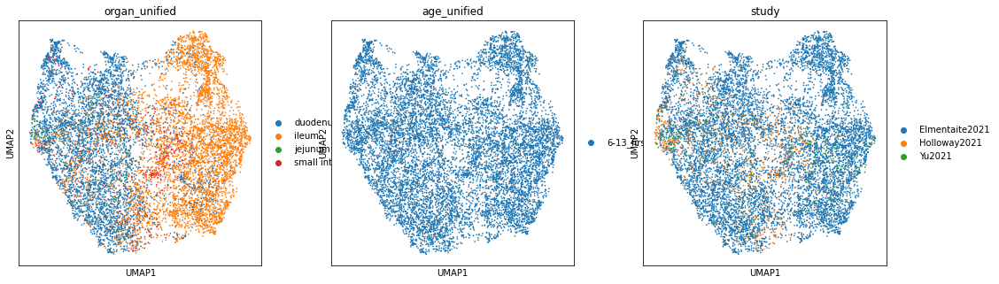

In [60]:
sc.pp.neighbors(
            pp,
            use_rep="X_scvi",
            n_pcs=pp.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(pp, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(pp, color=['organ_unified', 'age_unified','study'])

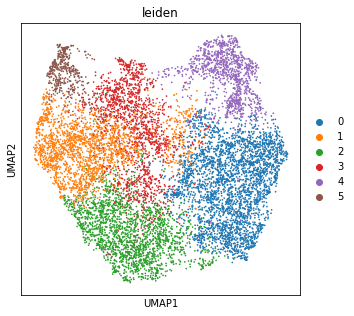

In [82]:
sc.tl.leiden(pp, resolution = 0.5, neighbors_key="neighbors_scvi")
sc.pl.umap(pp, color=['leiden'])

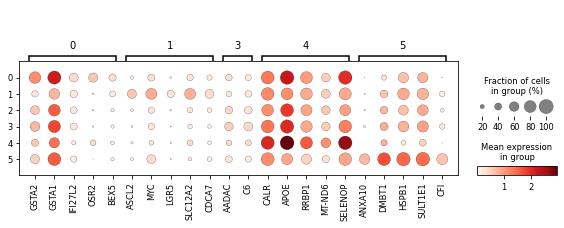

In [83]:
pp.raw = pp.copy()
mkst = calc_marker_stats(pp, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(pp, groupby='leiden', mks=mks)

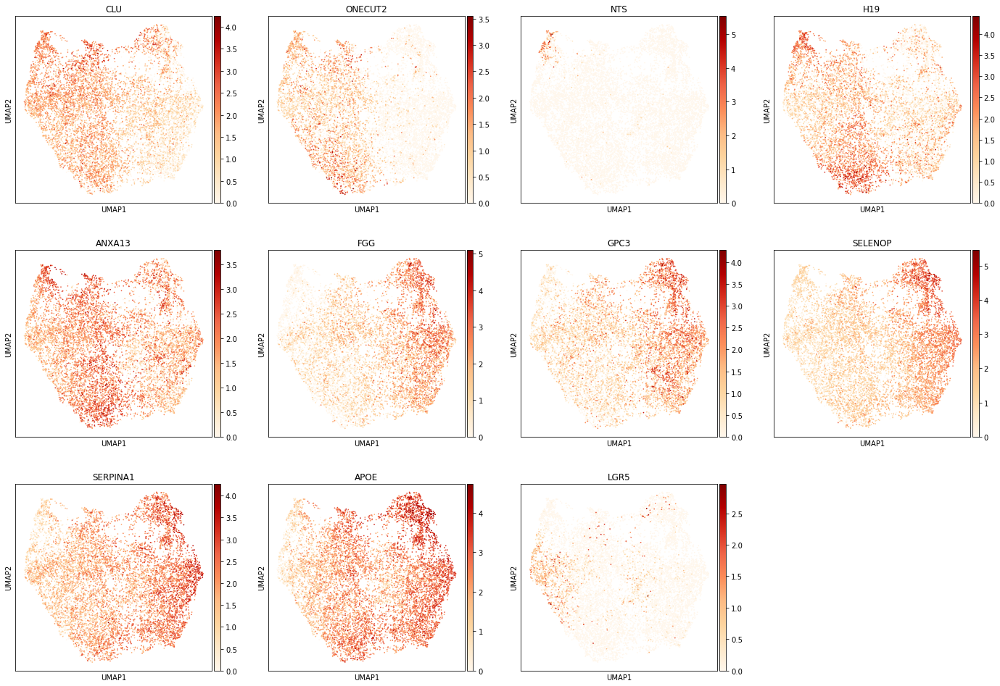

In [85]:
sc.pl.umap(pp,color=['CLU','ONECUT2','NTS','H19','ANXA13','FGG','GPC3','SELENOP','SERPINA1','APOE','LGR5'],cmap='OrRd')

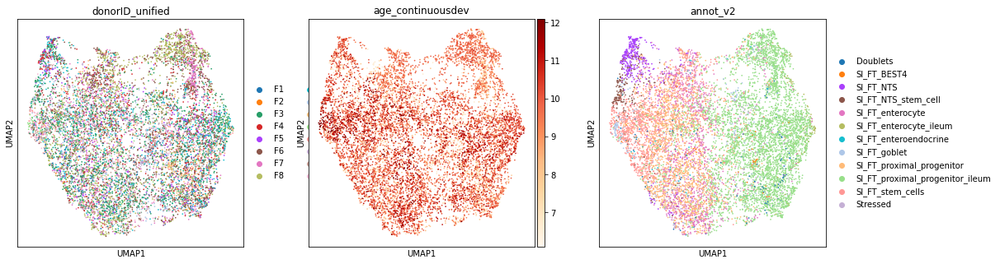

In [86]:
sc.pl.umap(pp,color=['donorID_unified','age_continuousdev','annot_v2'],cmap='OrRd')

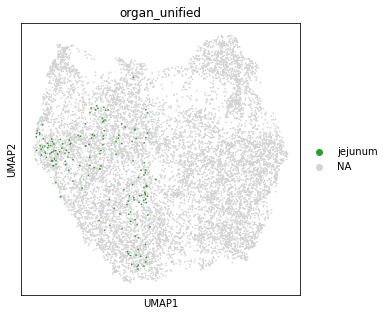

In [68]:
sc.pl.umap(pp, color=['organ_unified'],groups='jejunum')

In [69]:
adata.obs.organ_unified.value_counts()

duodenum           15135
ileum              13833
small intestine     1664
jejunum              924
Name: organ_unified, dtype: int64

In [88]:
new_cluster_names = [
    'SI_FT_proximal_progenitor_ILE','SI_FT_stem', #0,1
    'SI_FT_proximal_progenitor_DUO/JEJ','SI_FT_proximal_progenitor_DUO/JEJ', #2,3
    'SI_FT_proximal_progenitor_ILE','SI_FT_NTS' #4,5

]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

pp.obs['annot_v3'] = [conv[x] for x in pp.obs['leiden']]

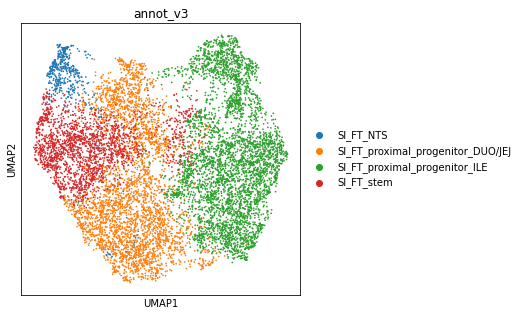

In [89]:
sc.pl.umap(pp,color='annot_v3')

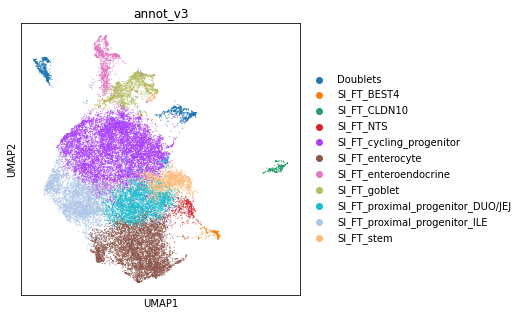

In [90]:
ON = {O:N for O,N in zip(pp.obs_names,pp.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [91]:
cycling = adata[adata.obs.annot_v3.isin(['SI_FT_cycling_progenitor'])].copy()

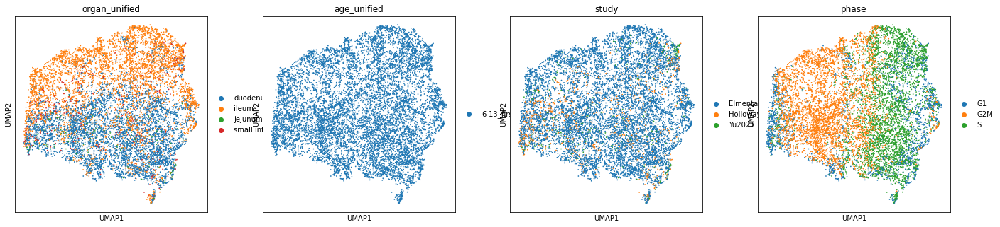

In [93]:
sc.pp.neighbors(
            cycling,
            use_rep="X_scvi",
            n_pcs=cycling.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(cycling, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(cycling, color=['organ_unified', 'age_unified','study','phase'])

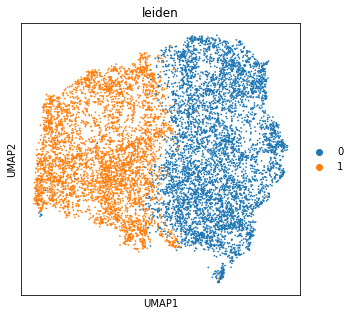

In [100]:
sc.tl.leiden(cycling, resolution = 0.2, neighbors_key="neighbors_scvi")
sc.pl.umap(cycling, color=['leiden'])

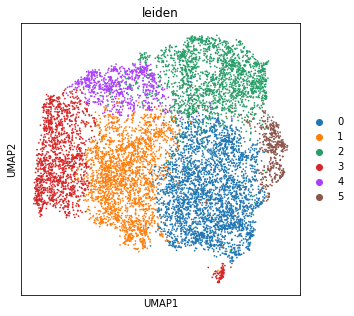

In [123]:
sc.tl.leiden(cycling, resolution = 0.5, neighbors_key="neighbors_scvi")
sc.pl.umap(cycling, color=['leiden'])

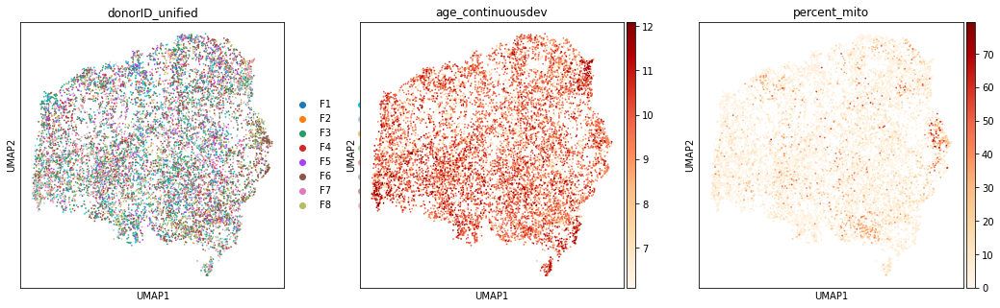

In [108]:
sc.pl.umap(cycling,color=['donorID_unified','age_continuousdev','percent_mito'],cmap='OrRd')

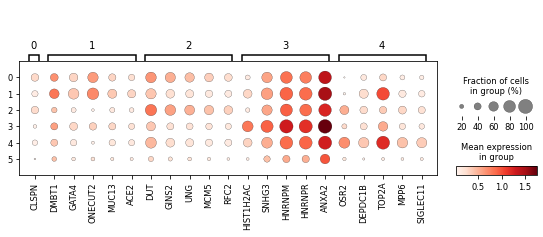

In [98]:
cycling.raw = cycling.copy()
mkst = calc_marker_stats(cycling, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(cycling, groupby='leiden', mks=mks)

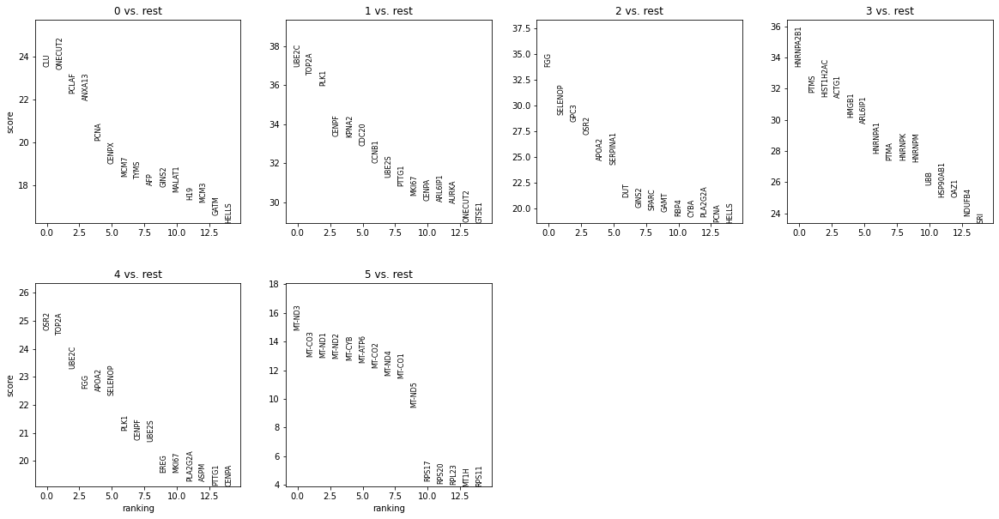

In [99]:
sc.tl.rank_genes_groups(cycling, 'leiden', method='wilcoxon')
sc.pl.rank_genes_groups(cycling, n_genes=15, sharey=False)

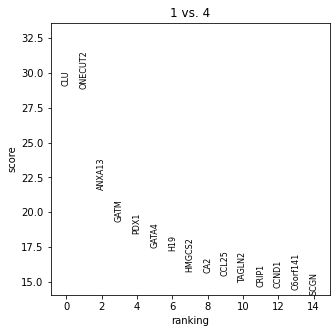

In [110]:
sc.tl.rank_genes_groups(cycling, 'leiden', method='wilcoxon',reference='4',groups=['1'])
sc.pl.rank_genes_groups(cycling, n_genes=15, sharey=False,groups=['1'])

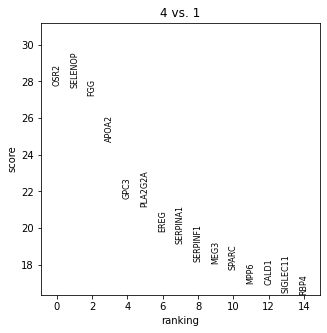

In [111]:
sc.tl.rank_genes_groups(cycling, 'leiden', method='wilcoxon',reference='1',groups=['4'])
sc.pl.rank_genes_groups(cycling, n_genes=15, sharey=False,groups=['4'])

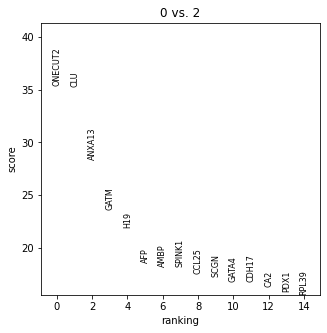

In [112]:
sc.tl.rank_genes_groups(cycling, 'leiden', method='wilcoxon',reference='2',groups=['0'])
sc.pl.rank_genes_groups(cycling, n_genes=15, sharey=False,groups=['0'])

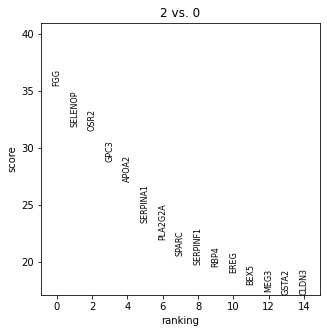

In [113]:
sc.tl.rank_genes_groups(cycling, 'leiden', method='wilcoxon',reference='0',groups=['2'])
sc.pl.rank_genes_groups(cycling, n_genes=15, sharey=False,groups=['2'])

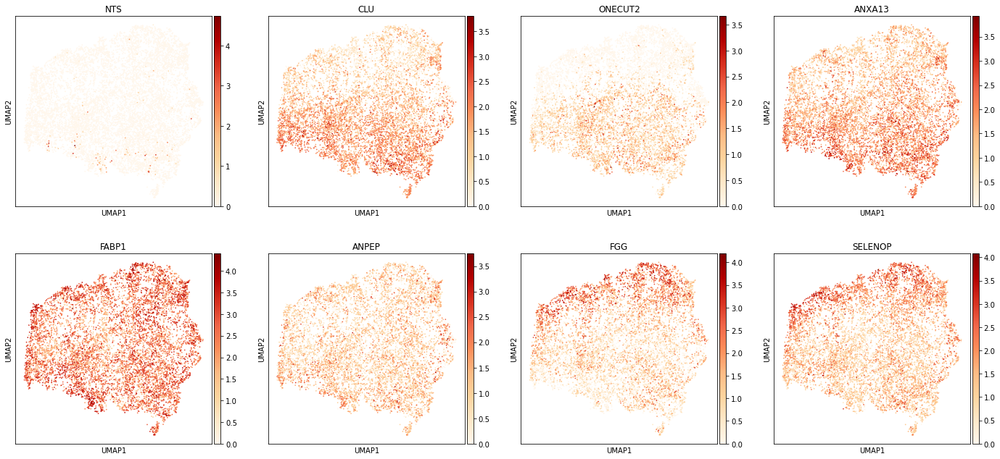

In [115]:
sc.pl.umap(cycling,color=['NTS','CLU','ONECUT2','ANXA13','FABP1','ANPEP','FGG','SELENOP'],cmap='OrRd')

         Falling back to preprocessing with `sc.pp.pca` and default params.


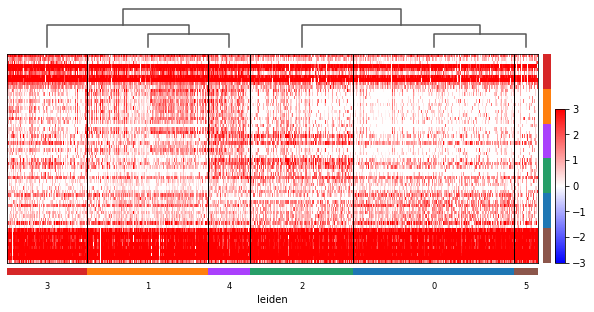

In [138]:
sc.tl.rank_genes_groups(cycling,groupby='leiden',method='wilcoxon')
sc.tl.dendrogram(cycling, groupby='leiden')
sc.pl.rank_genes_groups_heatmap(cycling,groupby='leiden', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=False,
                                vmin=-3, vmax=3, cmap='bwr')

In [119]:
new_cluster_names = [
    'SI_FT_cycling_S_DUO/JEJ','SI_FT_cycling_G2M_DUO/JEJ', #0,1
    'SI_FT_cycling_S_ILE','SI_FT_proximal_progenitor', #2,3
    'SI_FT_cycling_G2M_ILE','Doublets' #4,5 - no specific marker genes, high mito, exclude

]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

cycling.obs['annot_v3'] = [conv[x] for x in cycling.obs['leiden']]

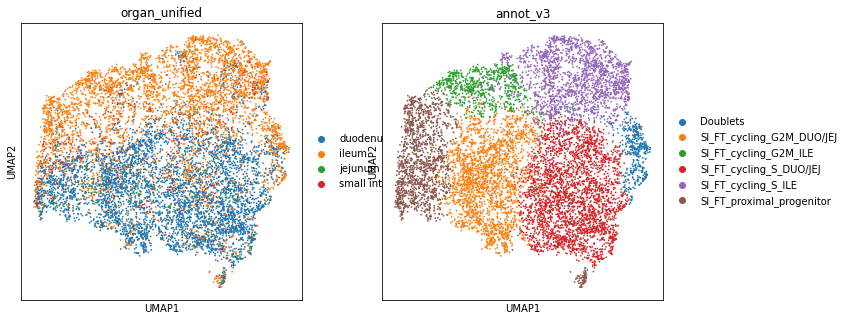

In [120]:
sc.pl.umap(cycling,color=['organ_unified','annot_v3'])

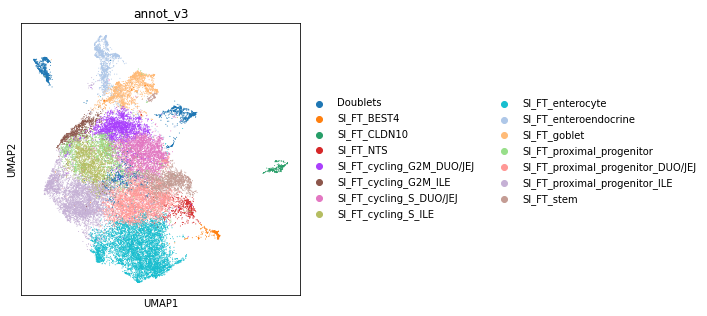

In [124]:
ON = {O:N for O,N in zip(cycling.obs_names,cycling.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [125]:
eec = adata[adata.obs.annot_v3.isin(['SI_FT_enteroendocrine'])].copy()

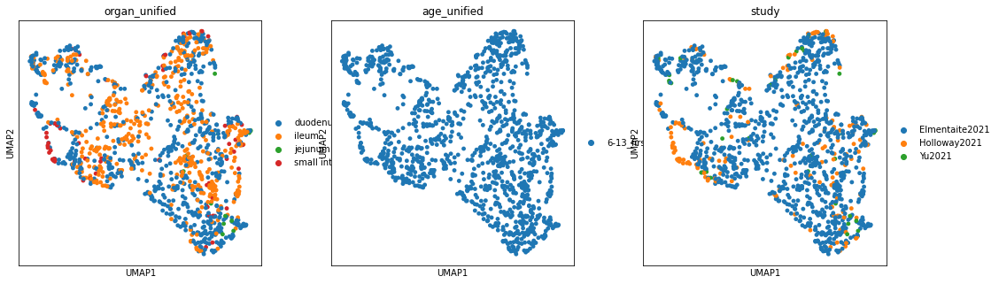

In [126]:
sc.pp.neighbors(
            eec,
            use_rep="X_scvi",
            n_pcs=eec.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(eec, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(eec, color=['organ_unified', 'age_unified','study'])

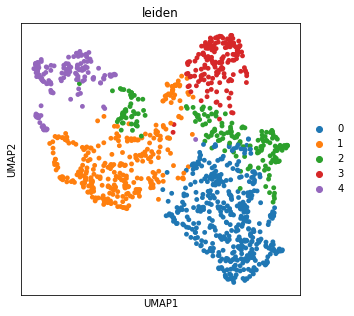

In [127]:
sc.tl.leiden(eec, resolution = 0.5, neighbors_key="neighbors_scvi")
sc.pl.umap(eec, color=['leiden'])

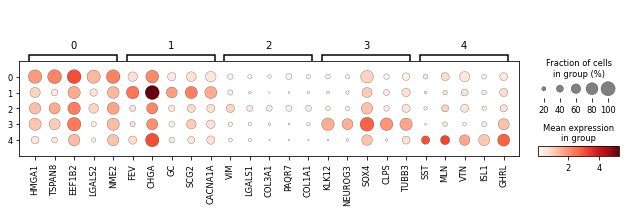

In [128]:
eec.raw = eec.copy()
mkst = calc_marker_stats(eec, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(eec, groupby='leiden', mks=mks)

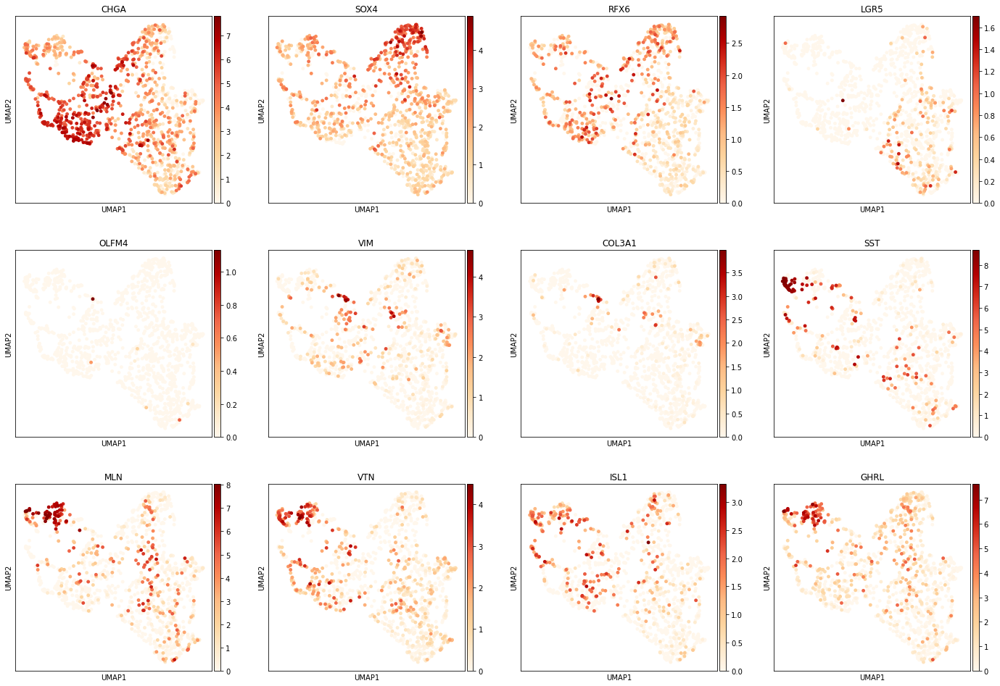

In [134]:
sc.pl.umap(eec,color=['CHGA','SOX4','RFX6','LGR5','OLFM4','VIM','COL3A1','SST','MLN','VTN','ISL1','GHRL'],cmap='OrRd')

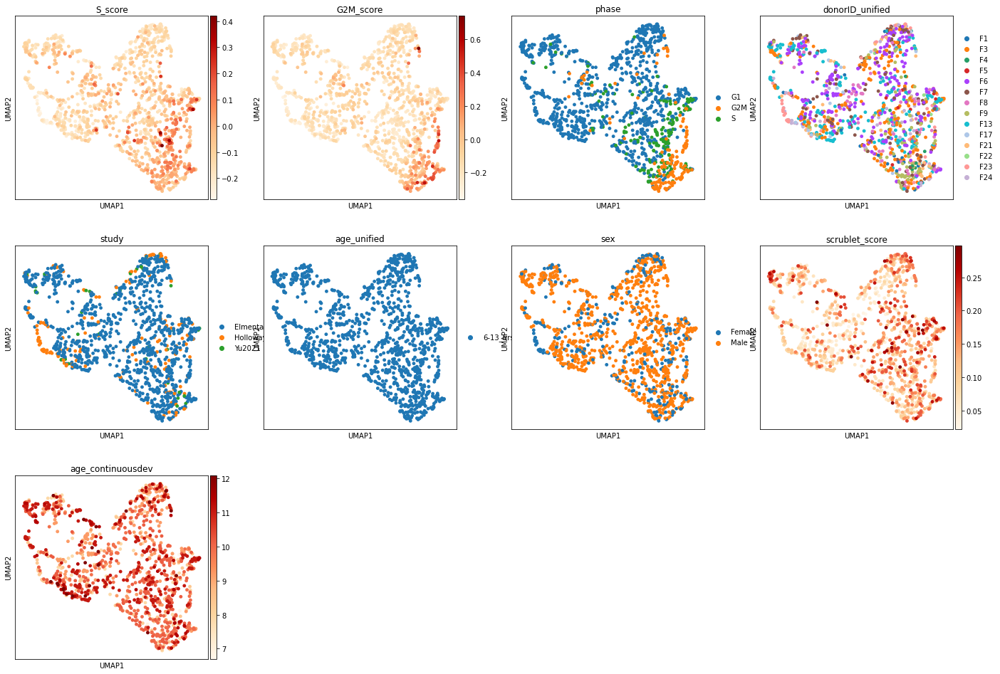

In [130]:
sc.pl.umap(eec,color=['S_score','G2M_score','phase','donorID_unified','study','age_unified','sex','scrublet_score','age_continuousdev'],cmap='OrRd')

In [135]:
new_cluster_names = [
    'SI_FT_enteroendocrine_stem','SI_FT_enteroendocrine', #0,1
    'Doublets','SI_FT_enteroendocrine_progenitor_SOX4', #2,3
    'SI_FT_enteroendocrine_mature'#4,5 

]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

eec.obs['annot_v3'] = [conv[x] for x in eec.obs['leiden']]

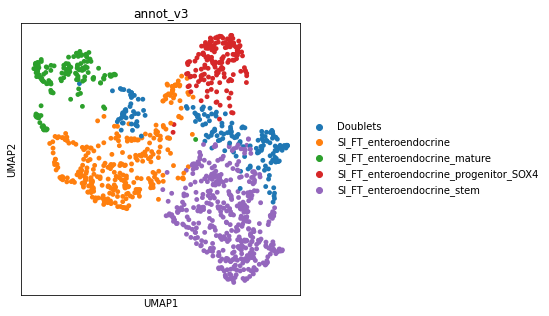

In [136]:
sc.pl.umap(eec,color='annot_v3')

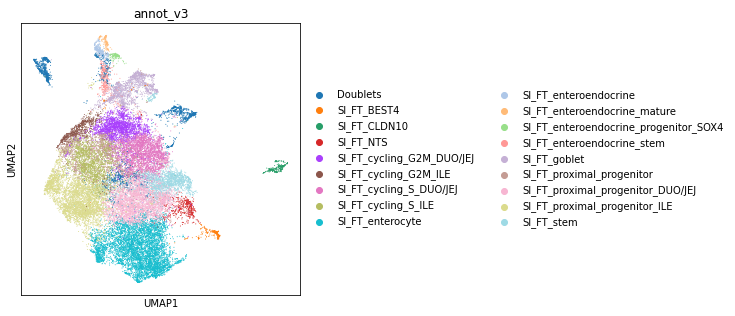

In [137]:
ON = {O:N for O,N in zip(eec.obs_names,eec.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [139]:
cld = adata[adata.obs.annot_v3.isin(['SI_FT_CLDN10'])].copy()

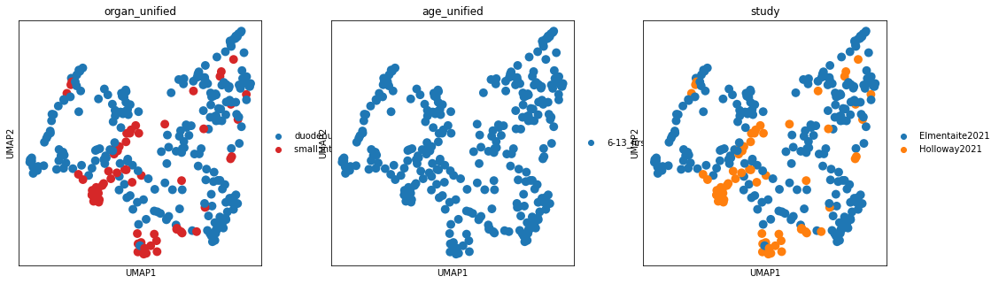

In [140]:
sc.pp.neighbors(
            cld,
            use_rep="X_scvi",
            n_pcs=cld.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(cld, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(cld, color=['organ_unified', 'age_unified','study'])

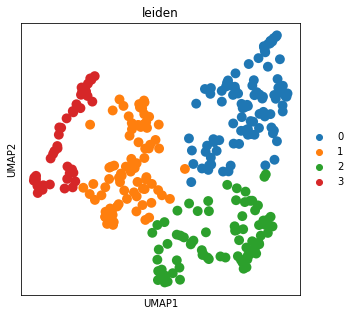

In [151]:
sc.tl.leiden(cld, resolution = 0.3,neighbors_key="neighbors_scvi")
sc.pl.umap(cld, color=['leiden'])

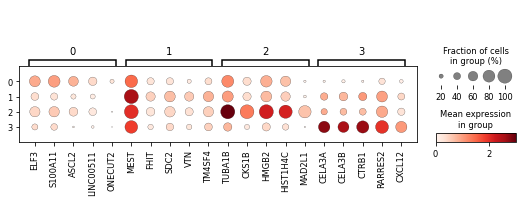

In [144]:
cld.raw = cld.copy()
mkst = calc_marker_stats(cld, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(cld, groupby='leiden', mks=mks)

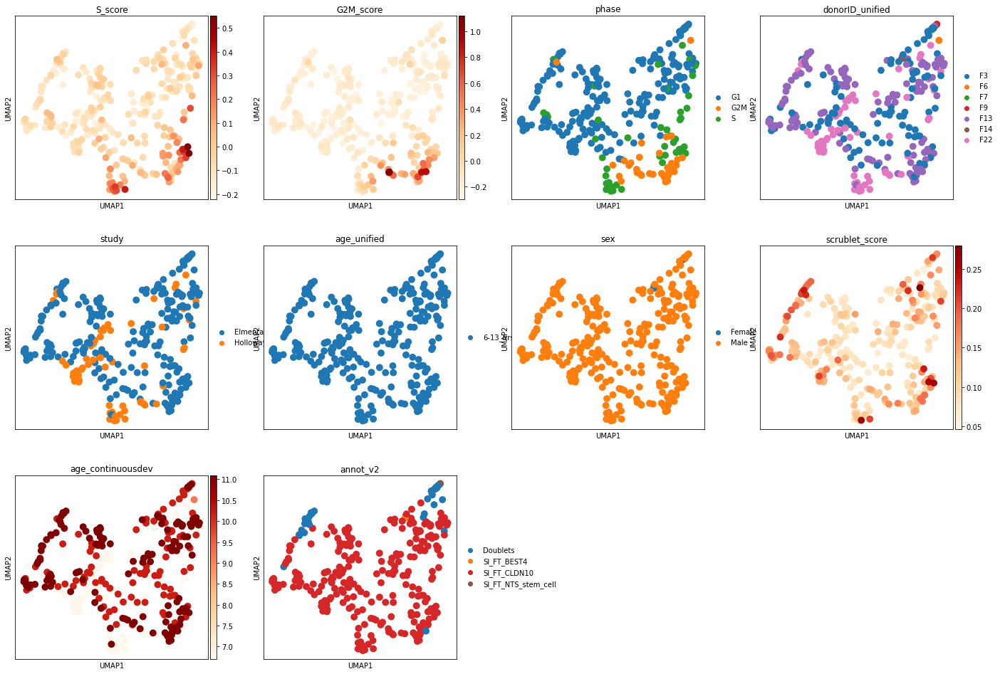

In [146]:
sc.pl.umap(cld,color=['S_score','G2M_score','phase','donorID_unified','study','age_unified','sex','scrublet_score','age_continuousdev','annot_v2'],cmap='OrRd')

In [152]:
nts_b4 = adata[adata.obs.annot_v3.isin(['SI_FT_NTS','SI_FT_BEST4'])].copy()

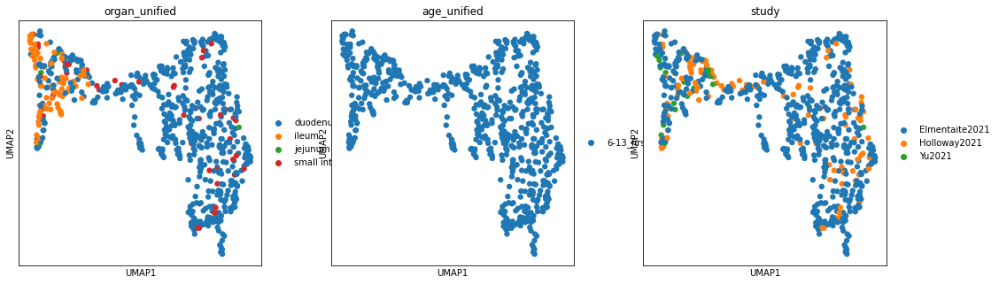

In [153]:
sc.pp.neighbors(
            nts_b4,
            use_rep="X_scvi",
            n_pcs=nts_b4.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(nts_b4, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(nts_b4, color=['organ_unified', 'age_unified','study'])

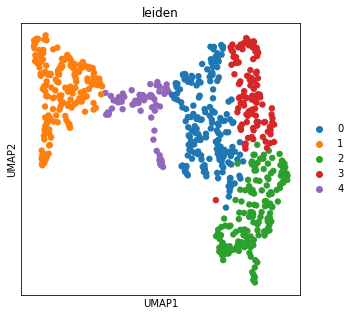

In [163]:
sc.tl.leiden(nts_b4, resolution = 0.5,neighbors_key="neighbors_scvi")
sc.pl.umap(nts_b4, color=['leiden'])

In [171]:
nts_b4.obs.leiden.value_counts()

0    188
1    187
2    172
3    113
4     72
Name: leiden, dtype: int64

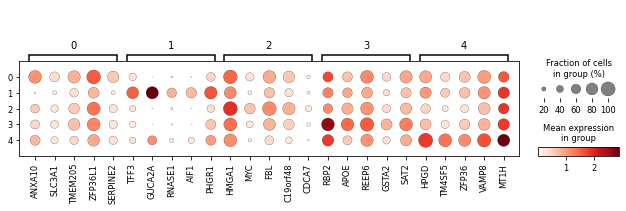

In [164]:
nts_b4.raw = nts_b4.copy()
mkst = calc_marker_stats(nts_b4, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(nts_b4, groupby='leiden', mks=mks)

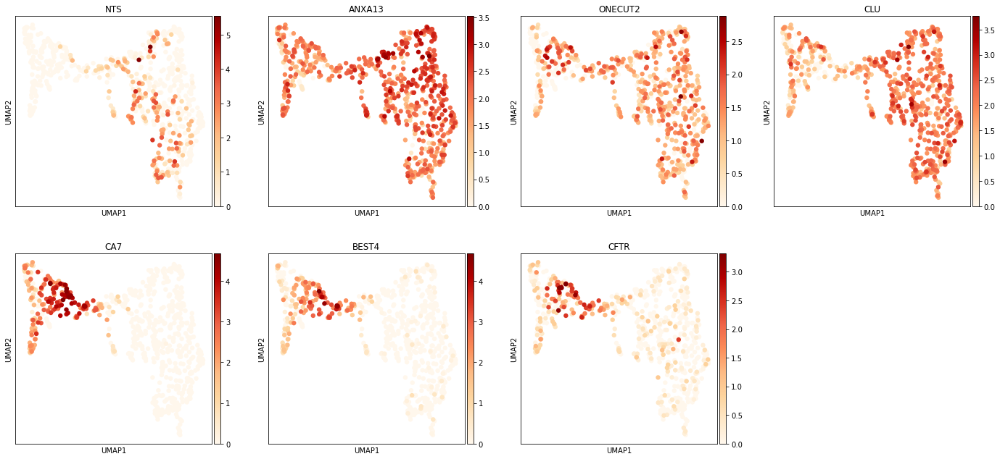

In [165]:
sc.pl.umap(nts_b4,color=['NTS','ANXA13','ONECUT2','CLU','CA7','BEST4','CFTR'],cmap='OrRd')

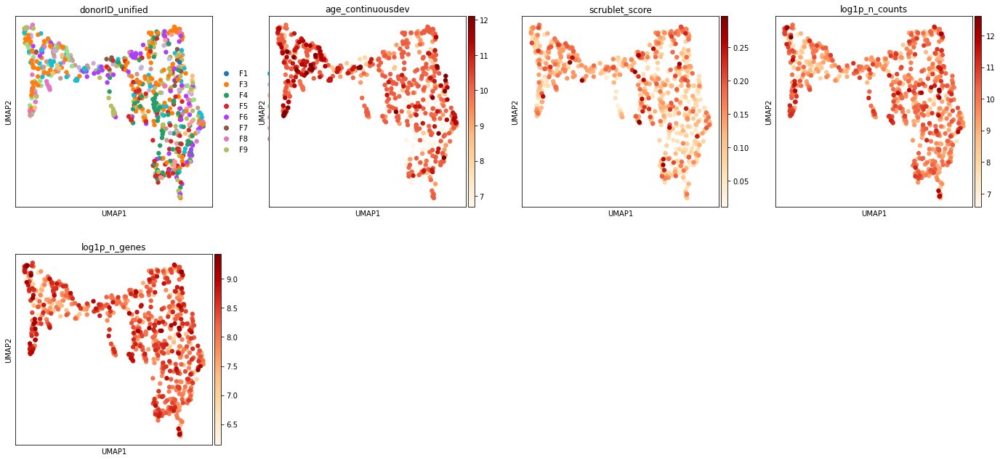

In [170]:
sc.pl.umap(nts_b4,color=['donorID_unified','age_continuousdev','scrublet_score','log1p_n_counts','log1p_n_genes'],cmap='OrRd')

In [172]:
new_cluster_names = [
    'SI_FT_NTS','SI_FT_BEST4', #0,1
    'SI_FT_NTS','SI_FT_NTS', #2,3
    'Doublets'#4 

]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

nts_b4.obs['annot_v3'] = [conv[x] for x in nts_b4.obs['leiden']]

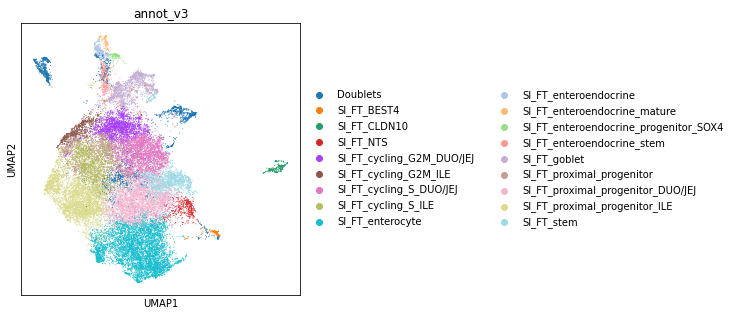

In [173]:
ON = {O:N for O,N in zip(nts_b4.obs_names,nts_b4.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [174]:
b4 = adata[adata.obs.annot_v3.isin(['SI_FT_BEST4'])].copy()

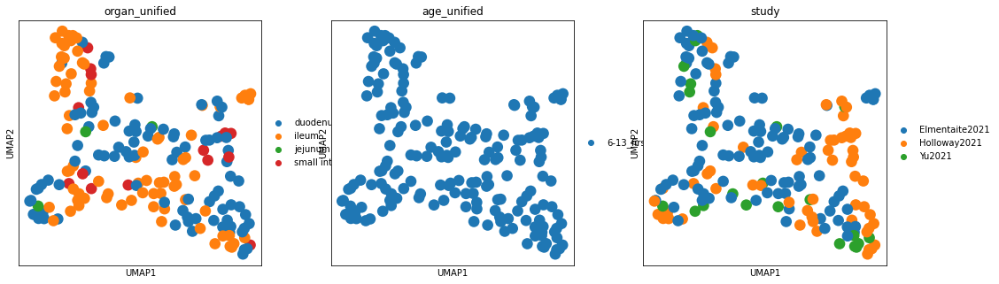

In [175]:
sc.pp.neighbors(
            b4,
            use_rep="X_scvi",
            n_pcs=b4.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(b4, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(b4, color=['organ_unified', 'age_unified','study'])

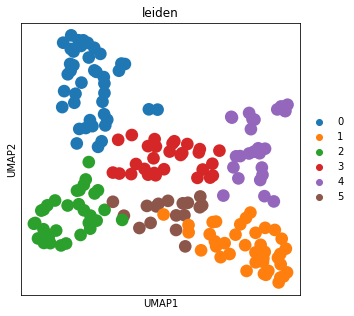

In [187]:
sc.tl.leiden(b4, resolution = 0.6,neighbors_key="neighbors_scvi")
sc.pl.umap(b4, color=['leiden'])

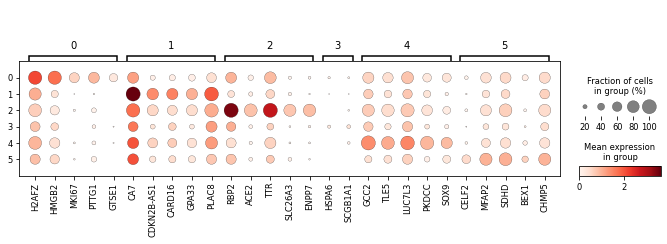

In [188]:
b4.raw = b4.copy()
mkst = calc_marker_stats(b4, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(b4, groupby='leiden', mks=mks)

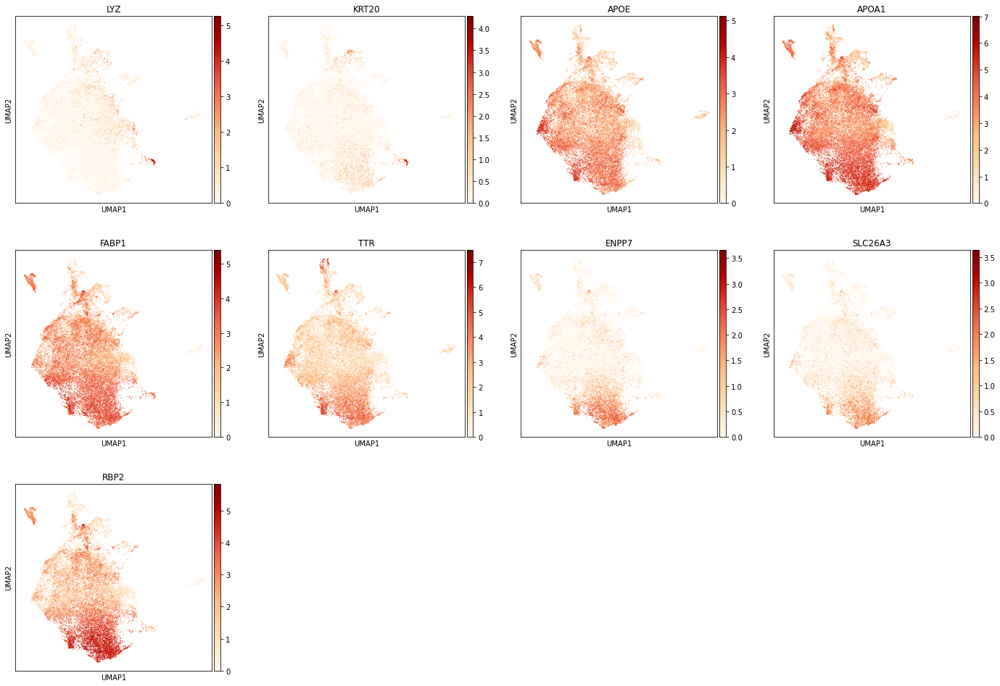

In [190]:
sc.pl.umap(adata,color=['LYZ','KRT20','APOE','APOA1','FABP1','TTR','ENPP7','SLC26A3','RBP2'],cmap='OrRd')

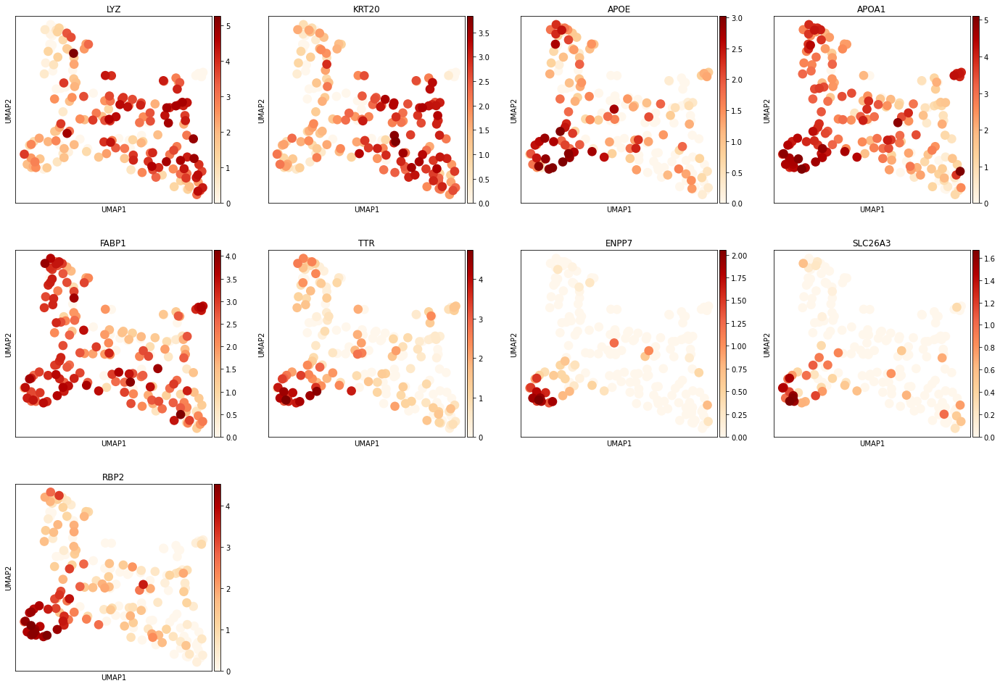

In [189]:
sc.pl.umap(b4,color=['LYZ','KRT20','APOE','APOA1','FABP1','TTR','ENPP7','SLC26A3','RBP2'],cmap='OrRd')

In [191]:
new_cluster_names = [
    'SI_FT_BEST4','SI_FT_BEST4', #0,1
    'Doublets','SI_FT_BEST4', #2,3
    'SI_FT_BEST4','SI_FT_BEST4'#4 

]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

b4.obs['annot_v3'] = [conv[x] for x in b4.obs['leiden']]

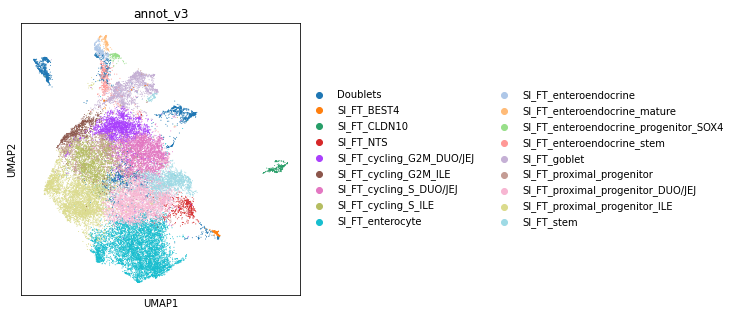

In [192]:
ON = {O:N for O,N in zip(b4.obs_names,b4.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [193]:
gob_stem = adata[adata.obs.annot_v3.isin(['SI_FT_goblet','SI_FT_stem'])].copy()

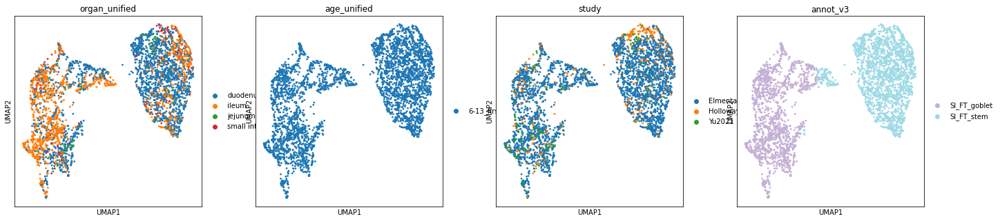

In [195]:
sc.pp.neighbors(
            gob_stem,
            use_rep="X_scvi",
            n_pcs=gob_stem.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(gob_stem, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(gob_stem, color=['organ_unified', 'age_unified','study','annot_v3'])

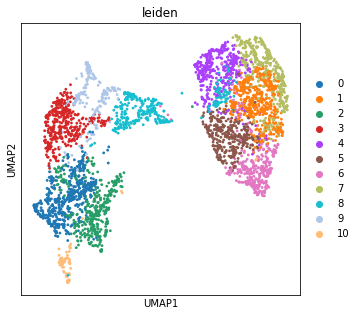

In [202]:
sc.tl.leiden(gob_stem, resolution = 1,neighbors_key="neighbors_scvi")
sc.pl.umap(gob_stem, color=['leiden'])

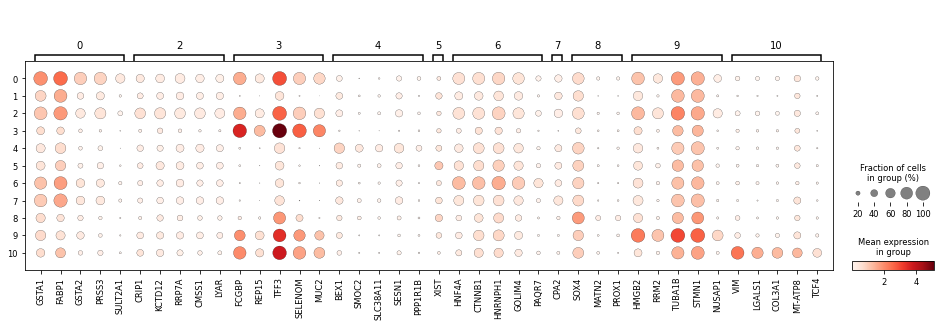

In [203]:
gob_stem.raw = gob_stem.copy()
mkst = calc_marker_stats(gob_stem, groupby="leiden")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(gob_stem, groupby='leiden', mks=mks)

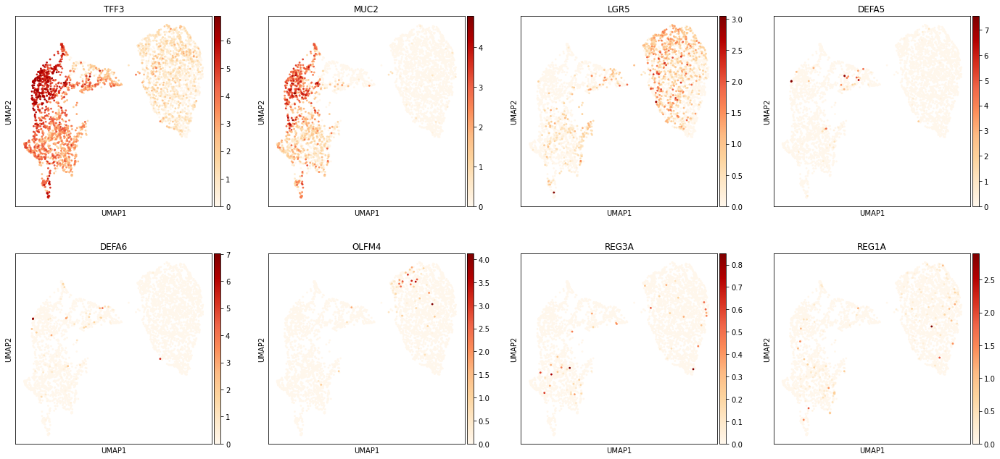

In [222]:
sc.pl.umap(gob_stem,color=['TFF3','MUC2','LGR5','DEFA5','DEFA6','OLFM4','REG3A','REG1A'],cmap='OrRd')

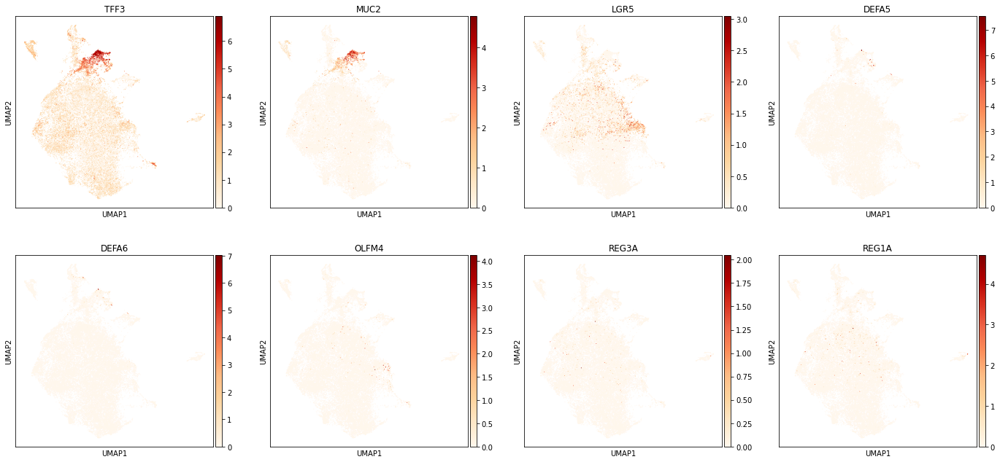

In [223]:
sc.pl.umap(adata,color=['TFF3','MUC2','LGR5','DEFA5','DEFA6','OLFM4','REG3A','REG1A'],cmap='OrRd')

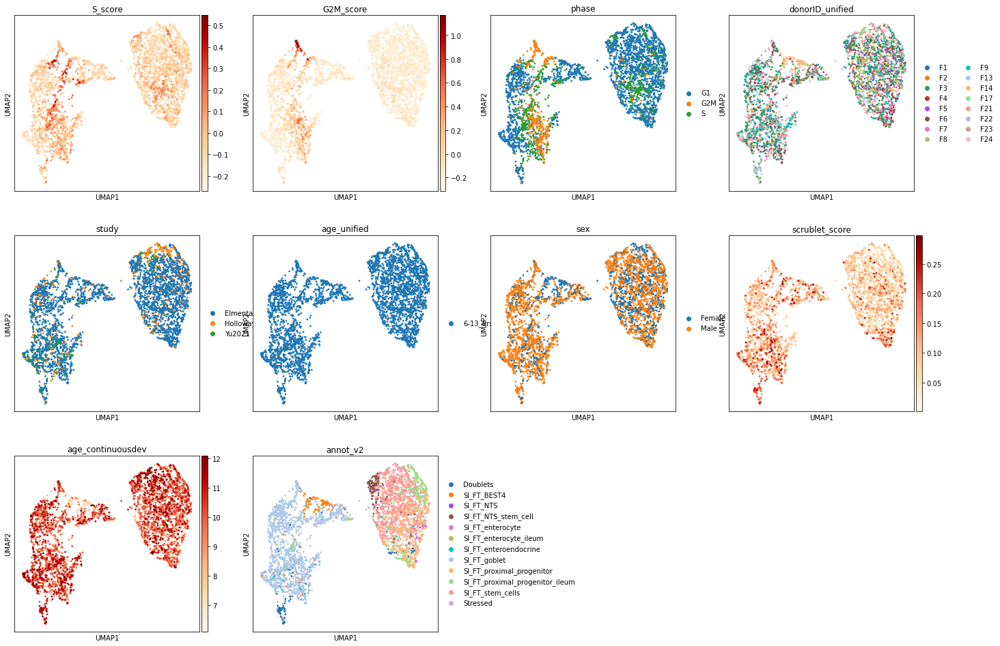

In [207]:
sc.pl.umap(gob_stem,color=['S_score','G2M_score','phase','donorID_unified','study','age_unified','sex','scrublet_score','age_continuousdev','annot_v2'],cmap='OrRd')

         Falling back to preprocessing with `sc.pp.pca` and default params.


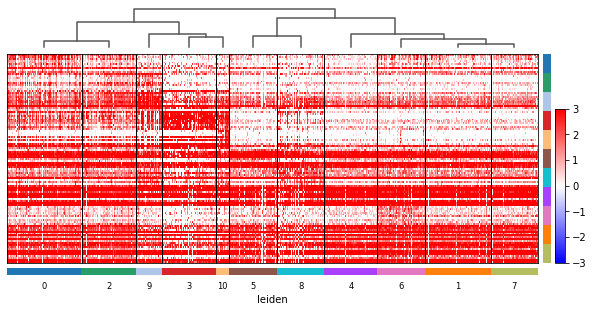

In [208]:
sc.tl.rank_genes_groups(gob_stem,groupby='leiden',method='wilcoxon')
sc.tl.dendrogram(gob_stem, groupby='leiden')
sc.pl.rank_genes_groups_heatmap(gob_stem,groupby='leiden', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=False,
                                vmin=-3, vmax=3, cmap='bwr')

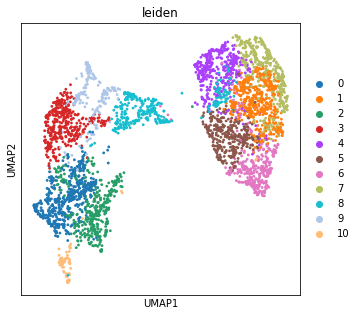

In [209]:
sc.pl.umap(gob_stem,color='leiden')

In [210]:
new_cluster_names = [
    'SI_FT_goblet','SI_FT_stem', #0,1
    'SI_FT_goblet','SI_FT_goblet', #2,3
    'SI_FT_stem','SI_FT_stem',#4,5
    'SI_FT_stem','SI_FT_stem',#6,7
    'SI_FT_goblet_stem?','SI_FT_goblet',#8,9
    'Doublets' #10

]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

gob_stem.obs['annot_v3'] = [conv[x] for x in gob_stem.obs['leiden']]

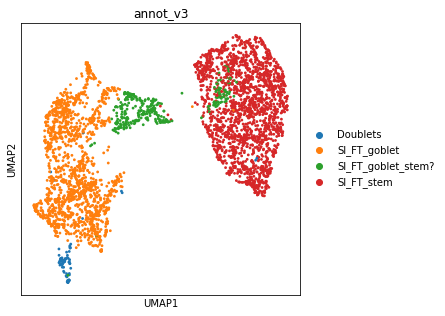

In [211]:
sc.pl.umap(gob_stem,color='annot_v3')

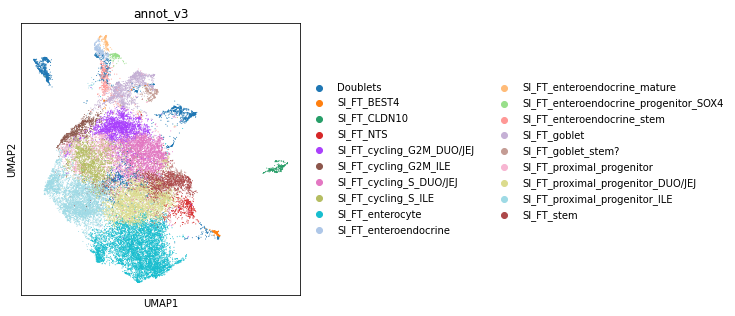

In [212]:
ON = {O:N for O,N in zip(gob_stem.obs_names,gob_stem.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [213]:
adata.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/SI_FT_epi.hvg5000_noRPL.scvi_output.annotv3.20221201.h5ad')

In [214]:
annot = adata.obs.loc[:,['annot_v2','annot_v3']]

In [224]:
annot.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/compartment_annotations/csv/SI_FT_epi_annot_v3_draft.csv')

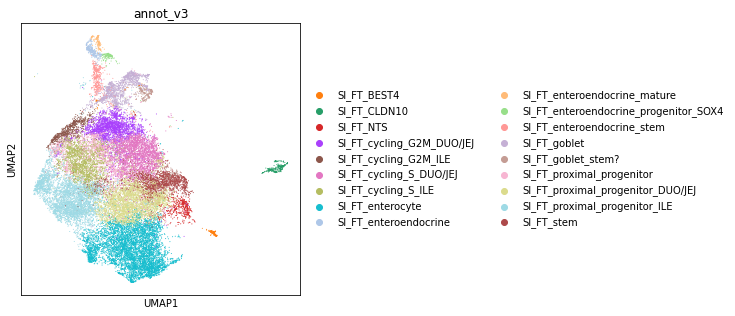

In [216]:
adata_nodoublets = adata[~adata.obs.annot_v3.isin(['Doublets'])].copy()
sc.pl.umap(adata_nodoublets,color='annot_v3')

In [217]:
adata_nodoublets.X.max()

8.705784

In [218]:
#recover raw
adata_nodoublets.X = adata_nodoublets.layers['counts']

In [219]:
adata_nodoublets.X.max()

10809.0

In [220]:
adata_nodoublets.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/pre_scvi20221124/no_doublets/SI_FT_epi.raw.annotv3.nodoublets.20221201.h5ad')

In [26]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/SI_FT_epi.hvg5000_noRPL.scvi_output.annotv3.20221201.h5ad')

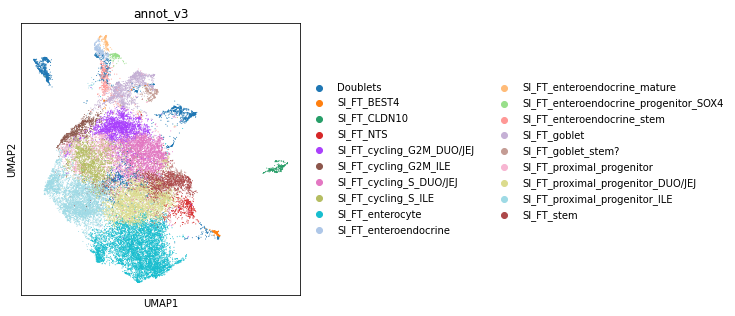

In [4]:
plt.rcParams['figure.figsize'] = [5,5]
sc.pl.umap(adata,color='annot_v3')

In [5]:
list(adata.obs.annot_v3.unique())

['Doublets',
 'SI_FT_enteroendocrine',
 'SI_FT_enterocyte',
 'SI_FT_proximal_progenitor_ILE',
 'SI_FT_proximal_progenitor_DUO/JEJ',
 'SI_FT_enteroendocrine_mature',
 'SI_FT_NTS',
 'SI_FT_proximal_progenitor',
 'SI_FT_BEST4',
 'SI_FT_goblet',
 'SI_FT_enteroendocrine_progenitor_SOX4',
 'SI_FT_cycling_S_DUO/JEJ',
 'SI_FT_CLDN10',
 'SI_FT_stem',
 'SI_FT_enteroendocrine_stem',
 'SI_FT_cycling_S_ILE',
 'SI_FT_goblet_stem?',
 'SI_FT_cycling_G2M_DUO/JEJ',
 'SI_FT_cycling_G2M_ILE']

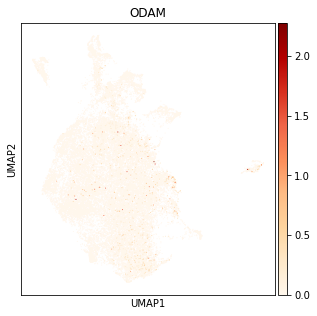

In [6]:
sc.pl.umap(adata,color='ODAM',cmap='OrRd')

In [7]:
gob = adata[adata.obs.annot_v3.isin(['SI_FT_goblet_stem?','SI_FT_goblet','SI_FT_stem'])]

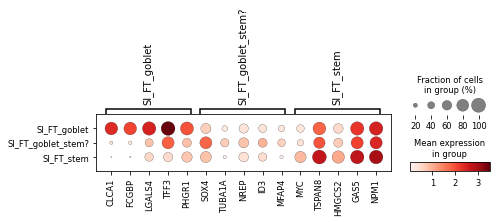

In [10]:
gob.raw = gob.copy()
mkst = calc_marker_stats(gob, groupby="annot_v3")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(gob, groupby='annot_v3', mks=mks)

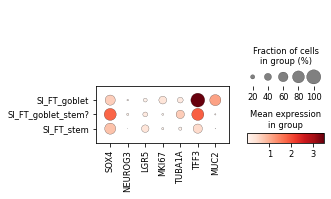

In [23]:
sc.pl.dotplot(gob,var_names=['SOX4','NEUROG3','LGR5','MKI67','TUBA1A','TFF3','MUC2'],groupby='annot_v3')

In [12]:
gob.uns['log1p']["base"] = None

         Falling back to preprocessing with `sc.pp.pca` and default params.


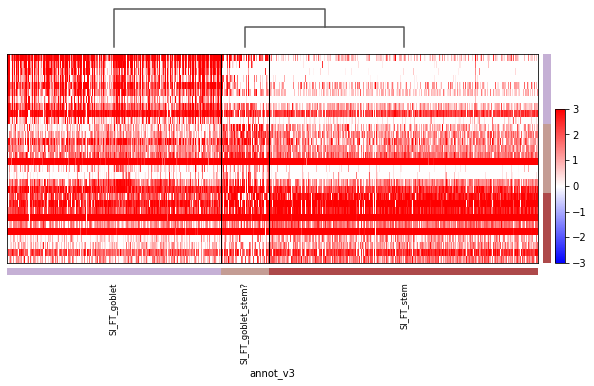

In [13]:
sc.tl.rank_genes_groups(gob,groupby='annot_v3',method='wilcoxon')
sc.tl.dendrogram(gob, groupby='annot_v3')
sc.pl.rank_genes_groups_heatmap(gob,groupby='annot_v3', n_genes=10, use_raw=False, swap_axes=True, show_gene_labels=False,
                                vmin=-3, vmax=3, cmap='bwr')

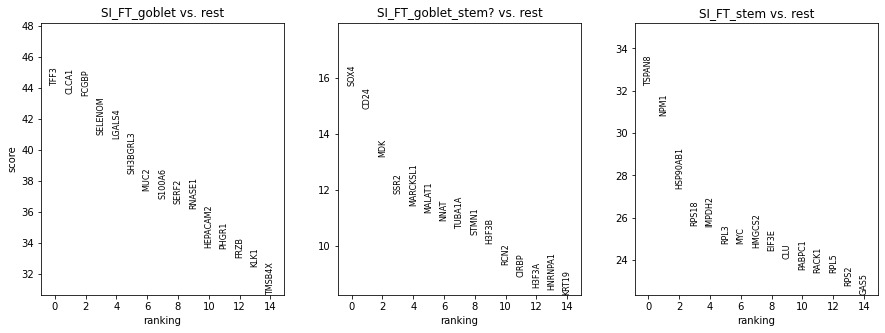

In [14]:
sc.tl.rank_genes_groups(gob, 'annot_v3', method='wilcoxon')
sc.pl.rank_genes_groups(gob, n_genes=15, sharey=False)

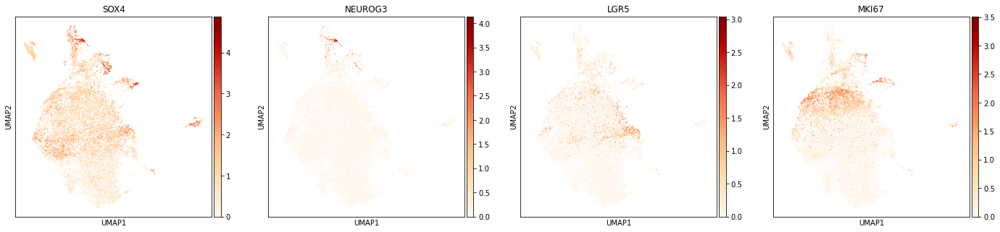

In [19]:
sc.pl.umap(adata,color=['SOX4','NEUROG3','LGR5','MKI67'],cmap='OrRd')

In [27]:
adata.obs['annot_v3'] = (
    adata.obs["annot_v3"]
    .map(lambda x: {'SI_FT_enteroendocrine_mature':'SI_FT_enteroendocrine',
                    'SI_FT_enteroendocrine_stem':'Doublets',
                    'SI_FT_enteroendocrine_progenitor_SOX4':'SI_FT_enteroendocrine_progenitor',
                   'SI_FT_cycling_S_ILE':'SI_FT_cycling_ILE',
                    'SI_FT_cycling_S_DUO/JEJ':'SI_FT_cycling_DUO/JEJ',
                    'SI_FT_cycling_G2M_DUO/JEJ':'SI_FT_cycling_DUO/JEJ',
                    'SI_FT_cycling_G2M_ILE':'SI_FT_cycling_ILE',
                    'SI_FT_goblet_stem?':'SI_FT_goblet_progenitor'
                    
                   }.get(x, x))
    .astype("category")
)

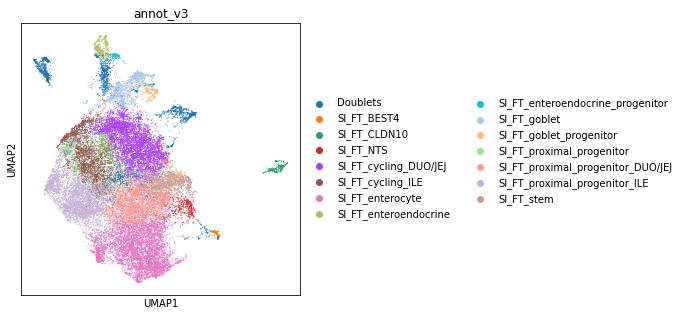

In [28]:
sc.pl.umap(adata,color='annot_v3')

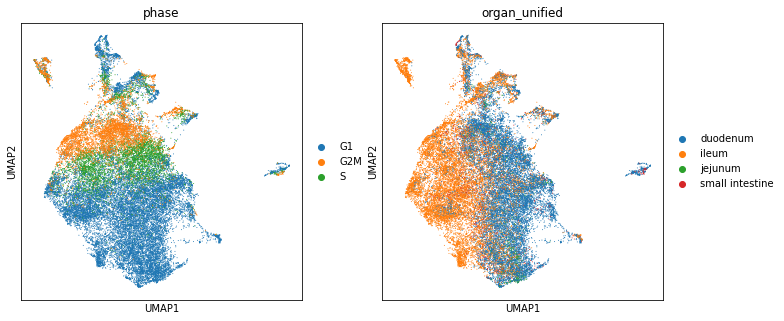

In [31]:
sc.pl.umap(adata,color=['phase','organ_unified'])

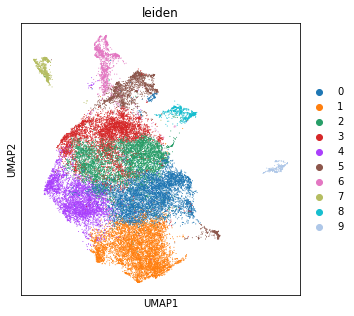

In [30]:
sc.pl.umap(adata,color='leiden')

In [32]:
adata.obs['annot_v3'] = (
    adata.obs["annot_v3"]
    .map(lambda x: {'SI_FT_proximal_progenitor':'SI_FT_cycling_ILE',
                    
                   }.get(x, x))
    .astype("category")
)

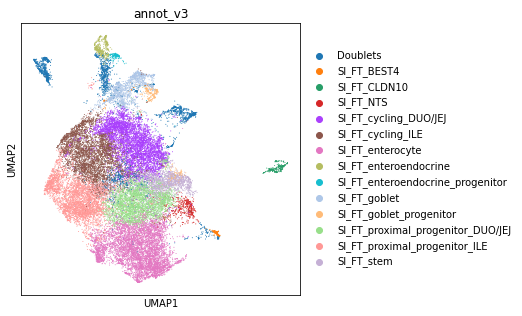

In [33]:
sc.pl.umap(adata,color='annot_v3')

In [35]:
pd.crosstab(adata.obs.annot_v3,adata.obs.organ_unified)

organ_unified,duodenum,ileum,jejunum,small intestine
annot_v3,,,,
Doublets,931,1479,27,71
SI_FT_BEST4,71,69,2,12
SI_FT_CLDN10,242,0,0,66
SI_FT_NTS,440,0,4,29
SI_FT_cycling_DUO/JEJ,3961,1059,145,203
SI_FT_cycling_ILE,845,3150,52,235
SI_FT_enterocyte,3439,1793,478,433
SI_FT_enteroendocrine,259,176,0,34
SI_FT_enteroendocrine_progenitor,90,67,1,10


In [36]:
adata.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/SI_FT_epi.hvg5000_noRPL.scvi_output.annotv3.20221206.h5ad')

In [37]:
annot = adata.obs.loc[:,['annot_v2','annot_v3']]

In [38]:
annot.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/compartment_annotations/csv/SI_FT_epi_annot_v3.csv')

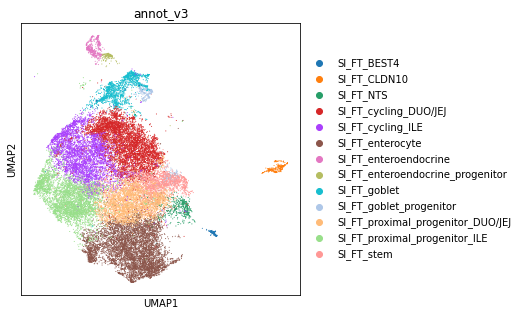

In [39]:
adata_nodoublets = adata[~adata.obs.annot_v3.isin(['Doublets'])].copy()
sc.pl.umap(adata_nodoublets,color='annot_v3')

In [40]:
adata_nodoublets.X.max()

8.705784

In [41]:
#recover raw
adata_nodoublets.X = adata_nodoublets.layers['counts']

In [42]:
adata_nodoublets.X.max()

10809.0

In [43]:
adata_nodoublets.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/pre_scvi20221124/no_doublets/SI_FT_epi.raw.annotv3.nodoublets.22021206.h5ad')

To make consistent to other objects, name cycling cells as G2M/S rather than location

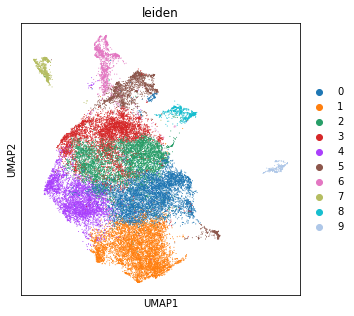

In [44]:
sc.pl.umap(adata,color='leiden')

In [45]:
cycling = adata[adata.obs.leiden.isin(['2','3'])].copy()

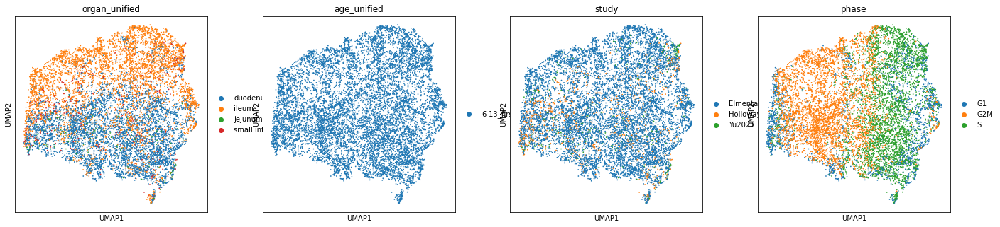

In [46]:
sc.pp.neighbors(
            cycling,
            use_rep="X_scvi",
            n_pcs=cycling.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(cycling, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(cycling, color=['organ_unified', 'age_unified','study','phase'])

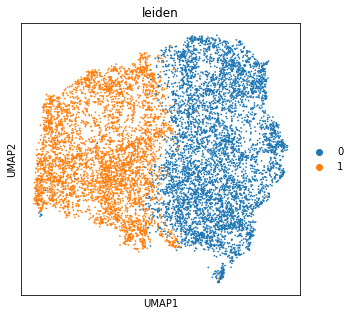

In [47]:
sc.tl.leiden(cycling, resolution = 0.2, neighbors_key="neighbors_scvi")
sc.pl.umap(cycling, color=['leiden'])

In [48]:
new_cluster_names = [
    'SI_FT_cycling_G2M','SI_FT_cycling_S' #0,1
]

conv = {str(i):name for i,name in enumerate(new_cluster_names)}

cycling.obs['annot_v3'] = [conv[x] for x in cycling.obs['leiden']]

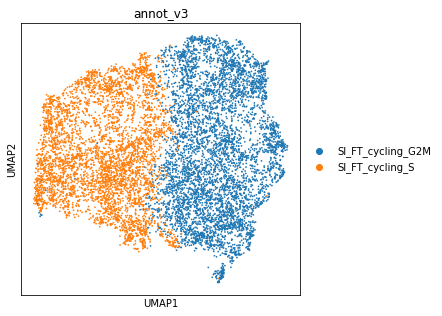

In [49]:
sc.pl.umap(cycling,color='annot_v3')

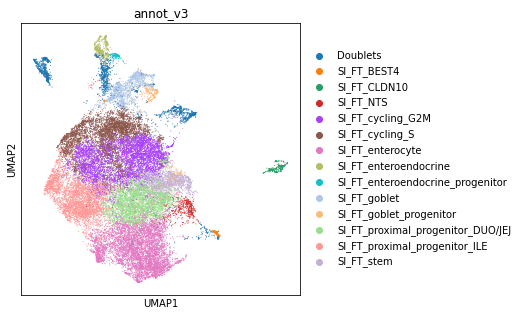

In [50]:
ON = {O:N for O,N in zip(cycling.obs_names,cycling.obs["annot_v3"])}
adata.obs["annot_v3"] = [ON[O] if O in ON else N for O,N in zip(adata.obs_names, adata.obs["annot_v3"])]
sc.pl.umap(adata,color='annot_v3')

In [51]:
adata.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/SI_FT_epi.hvg5000_noRPL.scvi_output.annotv3.20221206.h5ad')

In [2]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/SI_FT_epi.hvg5000_noRPL.scvi_output.annotv3.20221206.h5ad')

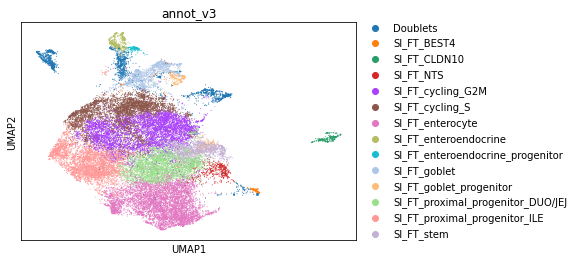

In [3]:
sc.pl.umap(adata,color='annot_v3')

In [4]:
annot = adata.obs.loc[:,['annot_v2','annot_v3']]

In [5]:
annot.to_csv('/nfs/team205/ao15/Megagut/Annotations_v3/compartment_annotations/csv/SI_FT_epi_annot_v3.csv')

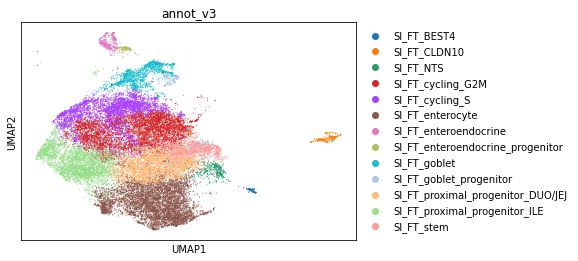

In [6]:
adata_nodoublets = adata[~adata.obs.annot_v3.isin(['Doublets'])].copy()
sc.pl.umap(adata_nodoublets,color='annot_v3')

In [7]:
#recover raw
adata_nodoublets.X = adata_nodoublets.layers['counts']

In [8]:
adata_nodoublets.X.max()

10809.0

In [9]:
adata_nodoublets.write_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/pre_scvi20221124/no_doublets/SI_FT_epi.raw.annotv3.nodoublets.22021206.h5ad')

## Plots for paper

In [1]:
import scanpy as sc
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
#make plots for paper

In [3]:
adata = sc.read_h5ad('/nfs/team205/ao15/Megagut/Annotations_v3/h5ad/compartments/annotated_v3/SI_FT_epi.hvg5000_noRPL.scvi_output.annotv3.20221206.h5ad')

In [4]:
annot = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/metadata/healthy_annotations_level1to3_20230127.csv',index_col=0)

/home/jovyan/my-conda-envs/standard_plotting/lib/python3.8/site-packages/scanpy/plotting/_tools/scatterplots.py:378: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


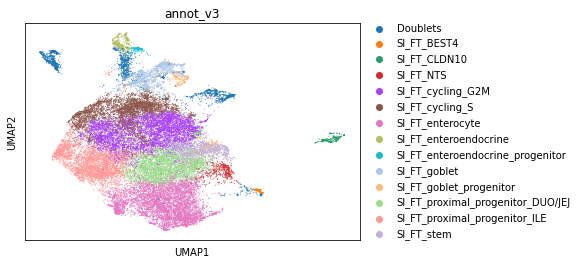

In [5]:
sc.pl.umap(adata,color='annot_v3')

In [6]:
adata.obs['fine_annot'] = annot.level_3_annot

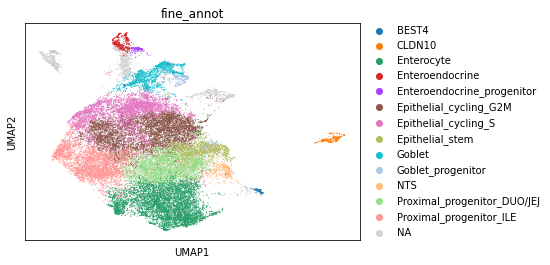

In [7]:
sc.pl.umap(adata,color='fine_annot')

In [8]:
adata.obs.fine_annot.cat.categories

Index(['BEST4', 'CLDN10', 'Enterocyte', 'Enteroendocrine',
       'Enteroendocrine_progenitor', 'Epithelial_cycling_G2M',
       'Epithelial_cycling_S', 'Epithelial_stem', 'Goblet',
       'Goblet_progenitor', 'NTS', 'Proximal_progenitor_DUO/JEJ',
       'Proximal_progenitor_ILE'],
      dtype='object')

In [9]:
adata = adata[adata.obs.fine_annot.isin(['BEST4', 'CLDN10', 'Enterocyte', 'Enteroendocrine',
       'Enteroendocrine_progenitor', 'Epithelial_cycling_G2M',
       'Epithelial_cycling_S', 'Epithelial_stem', 'Goblet',
       'Goblet_progenitor', 'NTS', 'Proximal_progenitor_DUO/JEJ',
       'Proximal_progenitor_ILE'])].copy()

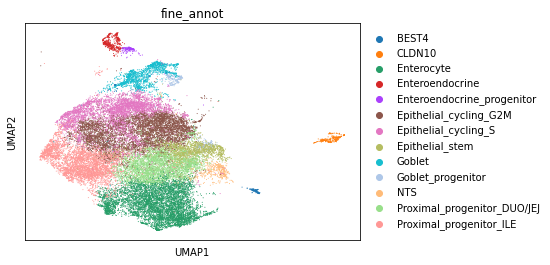

In [10]:
sc.pl.umap(adata,color='fine_annot')

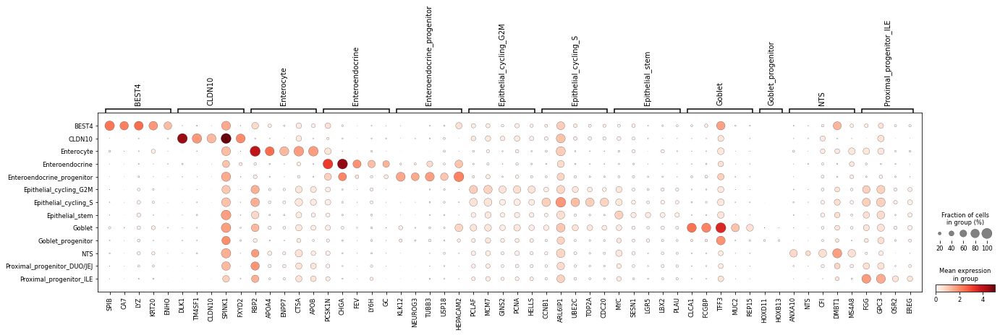

In [11]:
import sys
sys.path.append("/home/jovyan/ao15/Megagut/")
from re5_combine import *
adata.raw = adata.copy()
mkst = calc_marker_stats(adata, groupby="fine_annot")
mks = filter_marker_stats(mkst[2], min_frac_diff=0.1, min_mean_diff=0.1, max_next_frac=0.5, max_next_mean=0.95, strict=False, how='or')
plot_markers(adata, groupby='fine_annot', mks=mks)

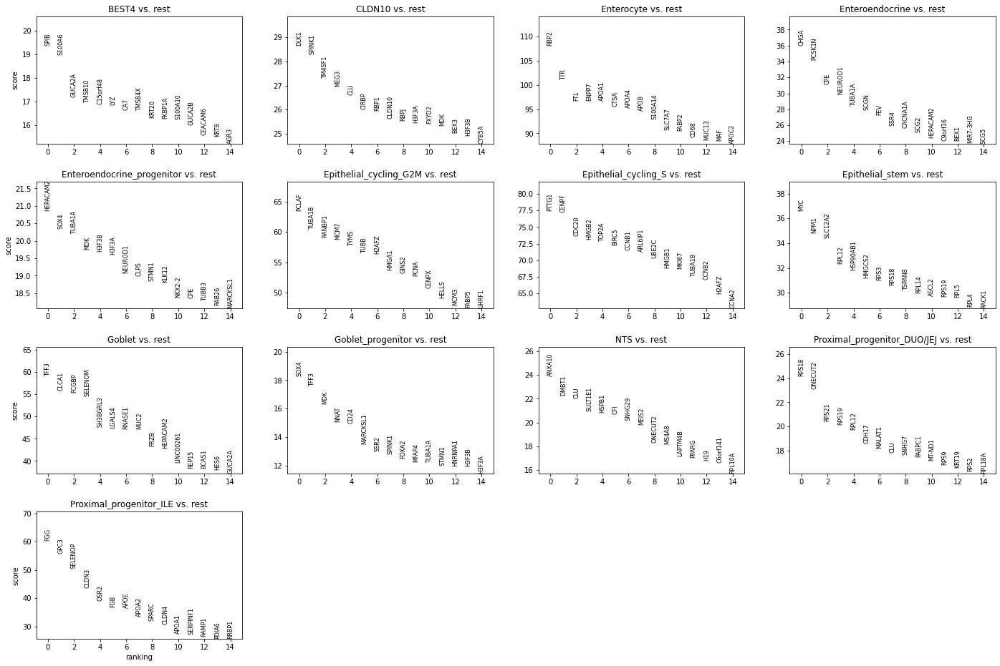

In [12]:
adata.uns['log1p']["base"] = None
sc.tl.rank_genes_groups(adata, 'fine_annot', method='wilcoxon')
sc.pl.rank_genes_groups(adata, n_genes=15, sharey=False)

In [13]:
marker_genes_dict = { 'BEST4 Enterocyte':['BEST4','CA7','SPIB','LYZ','KRT20'],
                     'CLDN10':['CLDN10','DLK1','CLU','FXYD2'],
                        'Enterocyte':['FABP1','APOA4','PRAP1','PCK1','RBP2','SI'],
                     'Enteroendocrine':['CHGA','PCSK1N','FEV','GC'],
                     'Enteroendocrine progenitor':['KLK12','NEUROG3','TUBB3','SOX4'],
                     'Cycling markers':['PCLAF','GINS2','TOP2A','CCNB1'],
                     'Stem':['LGR5','RGMB','MYC'],
                     'Goblet':['MUC2','TFF3','FCGBP','ZG16'],
                      'Goblet_progenitor':['GAU1','HOXB13','HOXD11'],
                     'NTS':['ANXA10','NTS','CFI','DMBT1','MS4A8'],
                     'Proximal progenitor':['FGG','GPC3','OSR2','EREG','FGB']
                     }

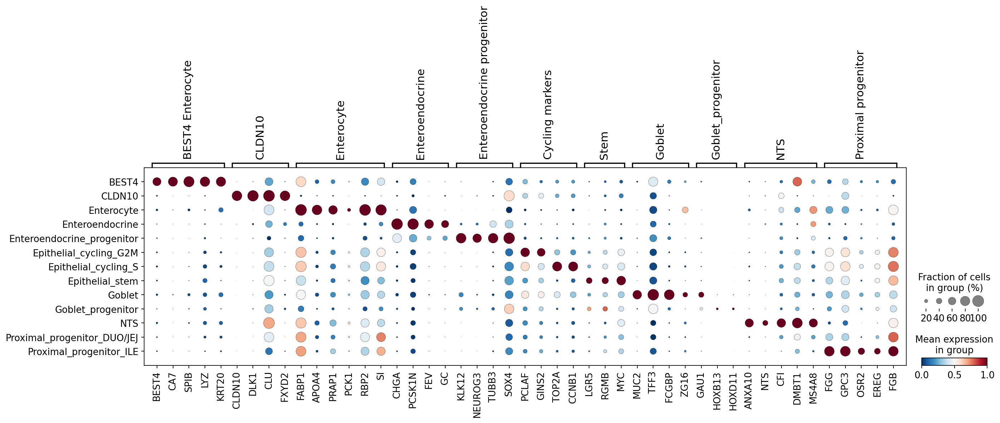

In [14]:
sc.set_figure_params(dpi_save = 300)
sc.pl.dotplot(adata,var_names=marker_genes_dict,groupby='fine_annot',save='Epi_SI_FT_markers.pdf',color_map='RdBu_r', standard_scale='var')

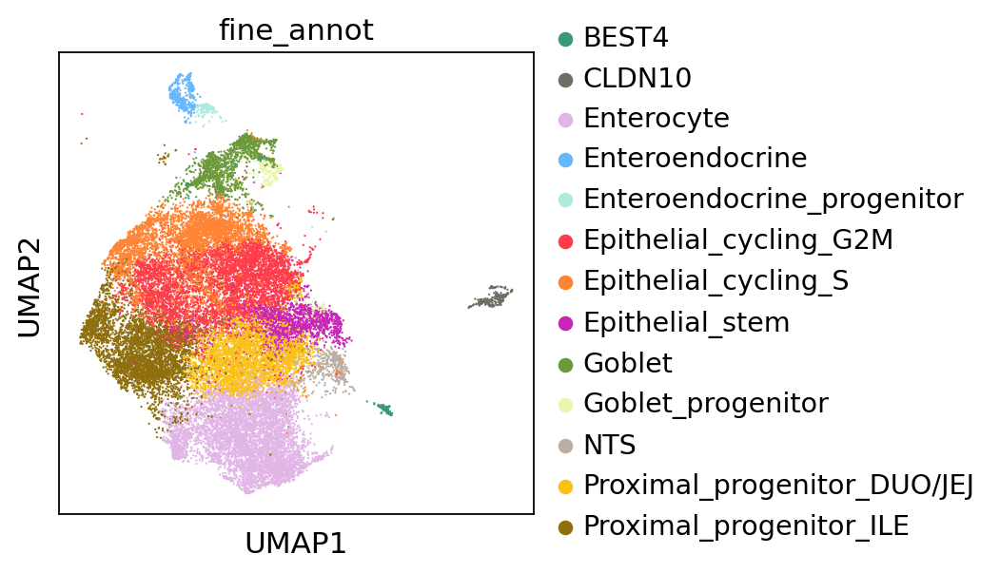

In [15]:
sc.pl.umap(adata,color='fine_annot',palette = ['#39997c',#BEST4
                                               '#706d65',#  'CLDN10': 
                                               '#e1b5e6',#enterocyte
                                                '#68b7fc',#enteroendocrine
                                                '#aeebdf',#'Enteroendocrine_progenitor': 
                                               '#ff3c4b',#'Epithelial_cycling_G2M': 
                                             '#ff8433',# 'Epithelial_cycling_S': 
                                            '#c924b9',#stem
                                               
                                               '#6c9939',#goblet
                                               '#e9f7ad',#goblet progenitor
                                               
                                                '#baada4',# 'NTS': 
                                                 '#fac219',#'Proximal_progenitor_DUO/JEJ':
                                               '#8f6e0d',#'Proximal_progenitor_ILE':

                                        
                                              ])

In [16]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
plt.rcParams['figure.figsize'] = [5,5]
sc.set_figure_params(dpi=300,dpi_save=600)

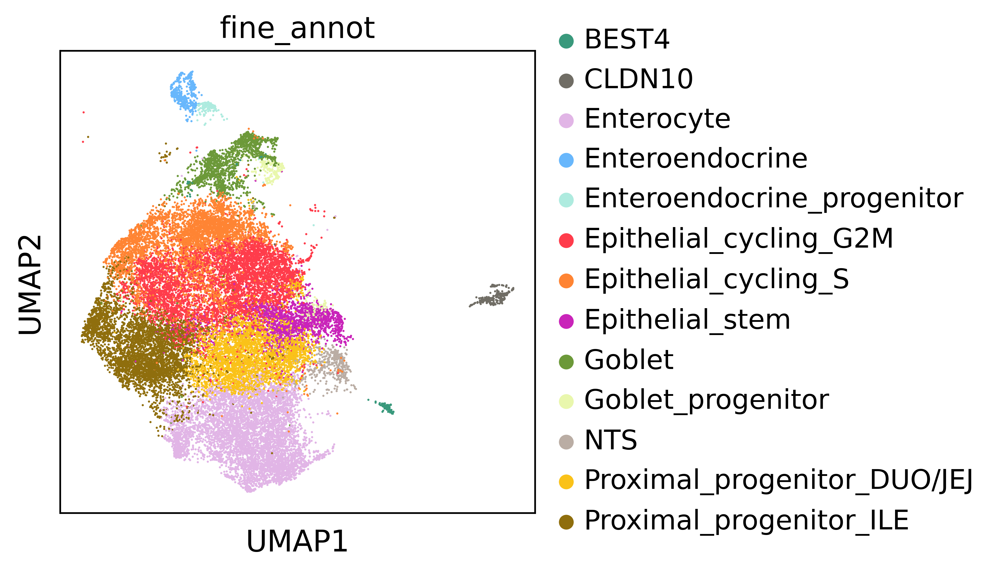

In [17]:
sc.pl.umap(adata,color='fine_annot',save='Epi_SI_FT_annot.png')

<AxesSubplot: title={'center': 'fine_annot'}, xlabel='UMAP1', ylabel='UMAP2'>

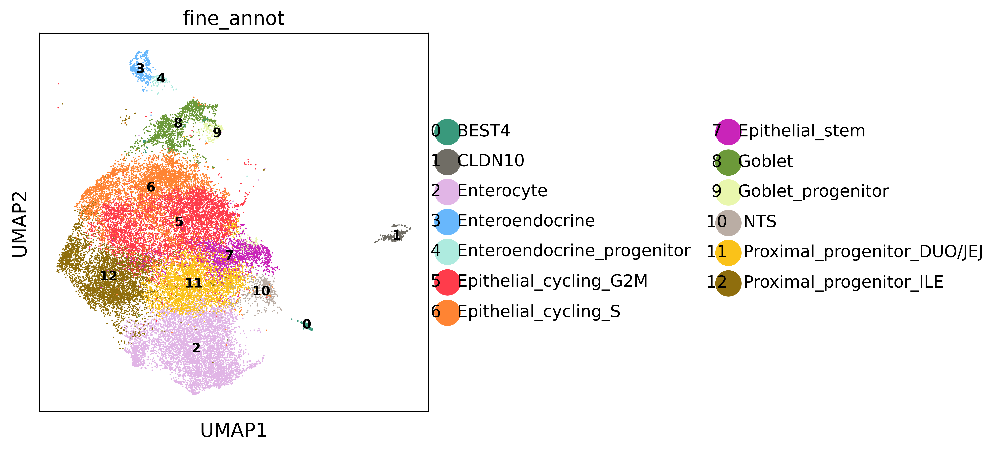

In [18]:
import sctk as sk
sk.plot_embedding(
    adata,
    basis="umap",
    groupby="fine_annot",
    figsize=(5, 5),
    save='figures/Epi_SI_FT_annot.png')

In [19]:
annot2 = pd.read_csv('/nfs/team205/ao15/Megagut/Annotations_v3/metadata/pooled_healthy_disease.plus_additional_epi.18485genes.with_fineannot.nodoublets.20230322.csv',index_col=0)

In [20]:
adata.obs['fine_annot2'] = annot2.level_3_annot

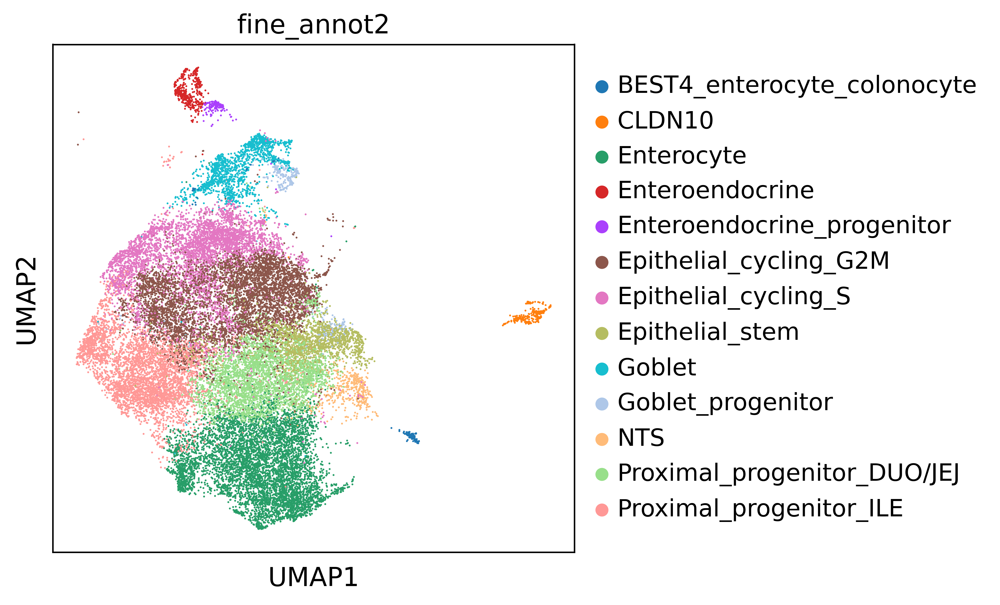

In [21]:
sc.pl.umap(adata,color='fine_annot2')

In [22]:
pd.crosstab(adata.obs.fine_annot,adata.obs.fine_annot2)

fine_annot2,BEST4_enterocyte_colonocyte,CLDN10,Enterocyte,Enteroendocrine,Enteroendocrine_progenitor,Epithelial_cycling_G2M,Epithelial_cycling_S,Epithelial_stem,Goblet,Goblet_progenitor,NTS,Proximal_progenitor_DUO/JEJ,Proximal_progenitor_ILE
fine_annot,,,,,,,,,,,,,
BEST4,154,0,0,0,0,0,0,0,0,0,0,0,0
CLDN10,0,308,0,0,0,0,0,0,0,0,0,0,0
Enterocyte,0,0,6143,0,0,0,0,0,0,0,0,0,0
Enteroendocrine,0,0,0,469,0,0,0,0,0,0,0,0,0
Enteroendocrine_progenitor,0,0,0,0,168,0,0,0,0,0,0,0,0
Epithelial_cycling_G2M,0,0,0,0,0,5529,0,0,0,0,0,0,0
Epithelial_cycling_S,0,0,0,0,0,0,4571,0,0,0,0,0,0
Epithelial_stem,0,0,0,0,0,0,0,1903,0,0,0,0,0
Goblet,0,0,0,0,0,0,0,0,1516,0,0,0,0


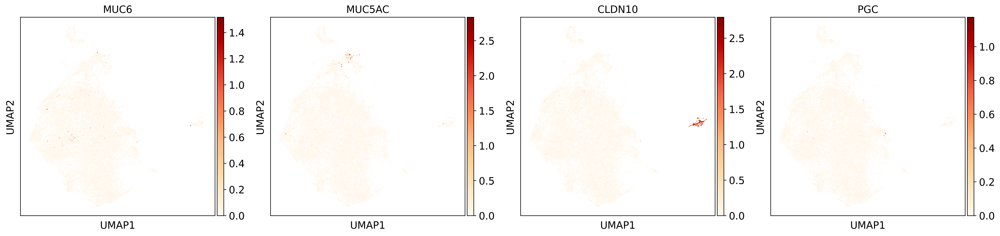

In [23]:
sc.pl.umap(adata,color=['MUC6','MUC5AC','CLDN10','PGC'],cmap='OrRd')

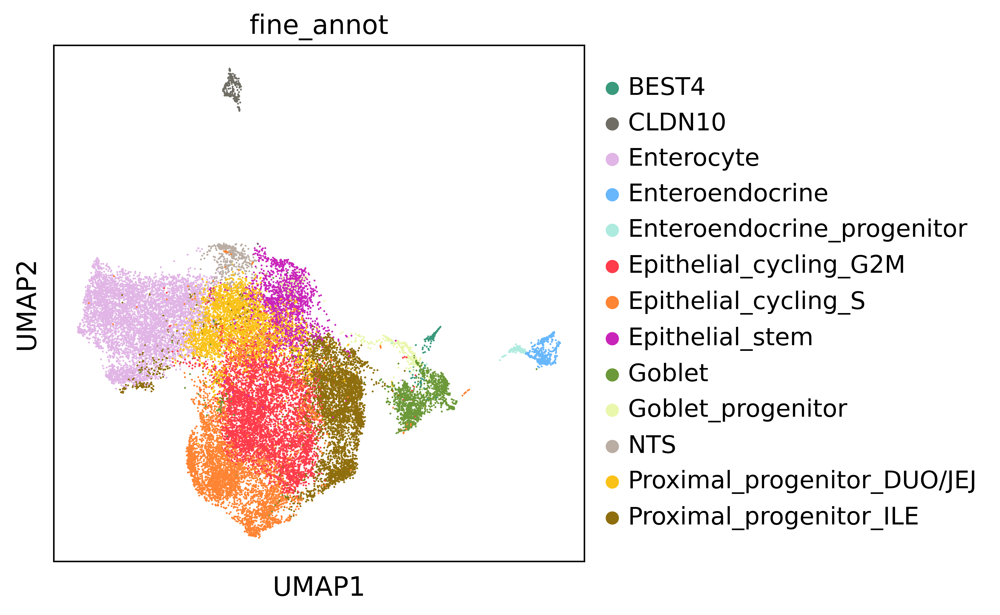

In [24]:
sc.pp.neighbors(
            adata,
            use_rep="X_scvi",
            n_pcs=adata.obsm["X_scvi"].shape[1],
            n_neighbors=15,
            key_added="neighbors_scvi",
        )
sc.tl.umap(adata, neighbors_key="neighbors_scvi", min_dist=0.1)
sc.pl.umap(adata, color='fine_annot')

In [25]:
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42
plt.rcParams['figure.figsize'] = [5,5]
sc.set_figure_params(dpi=300,dpi_save=600)

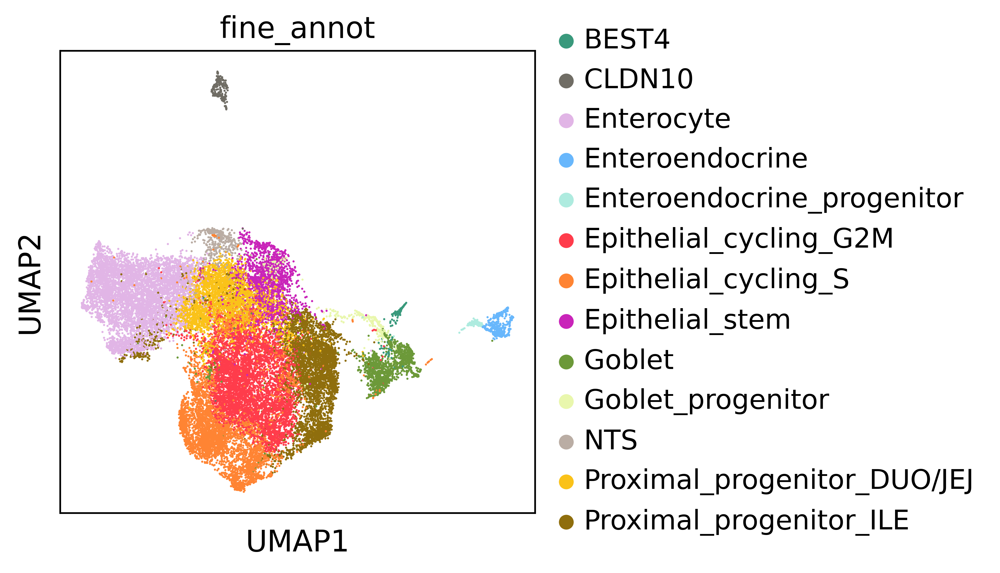

In [26]:
sc.pl.umap(adata,color='fine_annot',save='Epi_SI_FT_annot.png')

<AxesSubplot: title={'center': 'fine_annot'}, xlabel='UMAP1', ylabel='UMAP2'>

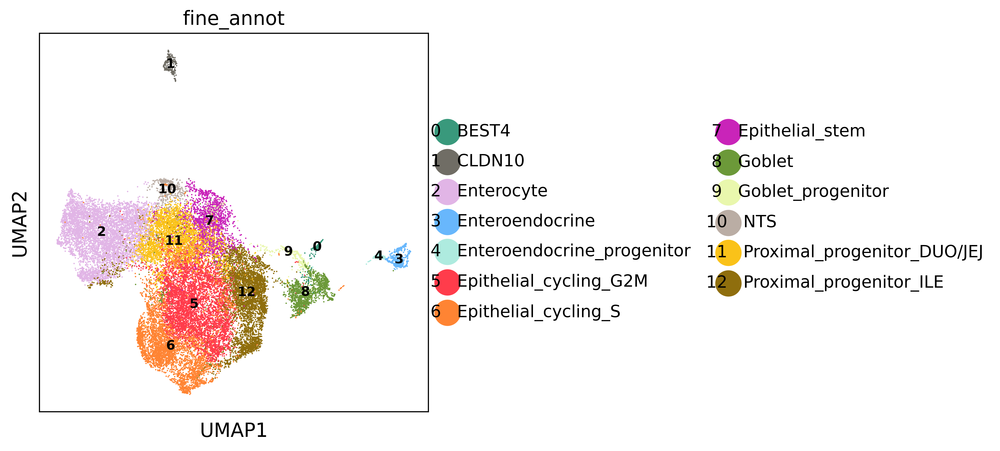

In [27]:
import sctk as sk
sk.plot_embedding(
    adata,
    basis="umap",
    groupby="fine_annot",
    figsize=(5, 5),
    save='figures/Epi_SI_FT_annot.png')